In [ ]:
!pip install numba==0.53
!pip install pycaret

# Machine Learning
from pycaret.regression import *
from pycaret.utils import enable_colab
enable_colab()

import pandas as pd
import numpy as np

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Colab mode enabled.


In [1]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Changes with config

In [ ]:
changes_config_km=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/changes_config_km.csv')

In [ ]:
changes_config_km.head()

,release,service type,fin,position number,months_of_age,country of registration,first_registration,new tire size,new manufacturer,tire price in eur,...,axle manufacturer,wheel brake type,Brake Width / Disc Thickness,brake diameter,Total_Price,month_year,as_on_date,avg_kilometers_per_annum,Vehicle Age,no.of.tyre_changes
0,2013-10-15,STANDARD,WKESD000000508287,5,24.0,Deutschland,2011-09-28,"385/65 R 22,5",Unknown,350.00,...,Unknown,Unknown,Unknown,Unknown,381.04,2013-10,2013-10-31,Unknown,d.18-24 mon,1
1,2013-10-15,STANDARD,WKESD000000508287,6,24.0,Deutschland,2011-09-28,"385/65 R 22,5",Unknown,350.00,...,Unknown,Unknown,Unknown,Unknown,364.81,2013-10,2013-10-31,Unknown,d.18-24 mon,1
2,2013-10-02,STANDARD,WKESD000000407428,1,69.0,Deutschland,2008-01-02,"385/65 R 22,5",Barum,330.46,...,Unknown,Unknown,Unknown,Unknown,346.75,2013-10,2013-10-31,Unknown,k.5-8 yrs,1
3,2013-10-02,STANDARD,WKESD000000407428,2,69.0,Deutschland,2008-01-02,"385/65 R 22,5",Barum,330.46,...,Unknown,Unknown,Unknown,Unknown,338.55,2013-10,2013-10-31,Unknown,k.5-8 yrs,1
4,2013-10-28,STANDARD,WKESD000000407432,1,69.0,Deutschland,2008-01-02,"385/65 R 22,5",Continental,330.46,...,Unknown,Unknown,Unknown,Unknown,338.55,2013-10,2013-10-31,Unknown,k.5-8 yrs,1


In [ ]:
changes_config_km['new tire size'].value_counts()

385/65 R 22,5    37721
385/55 R 22,5    18327
445/45 R 19,5     2048
425/65 R 22,5      205
435/50 R 19,5      106
11,00 R 22,5        59
235/75 R 17,5       45
275/70 R 22,5       26
385/55 R 19,5       24
215/55 R 17         21
265/70 R 19,5       12
205/55 R 16          7
275/40 R 18          6
225/40 R 18          6
225/45 R 17          4
225/55 R 16          4
215/60 R 16          4
205/60 R 16          4
245/45 R 18          4
245/70 R 17,5        4
245/40 R 19          4
235/55 R 18          4
235/40 R 19          3
275/35 R 19          2
225/45 R 19          2
245/45 R 19          2
365/80 R 20          1
Name: new tire size, dtype: int64

In [ ]:
changes_config_km['new tire size']=changes_config_km['new tire size'].replace( {'11,00 R 22,5':"011/90 R 22,5"})

In [ ]:
changes_config_km['tire_width']=changes_config_km['new tire size'].apply(lambda x: float(x[:3].replace(",",".")))
changes_config_km['aspect_ratio']=changes_config_km['new tire size'].apply(lambda x: float(x[4:7]))
changes_config_km['tire_diameter']=changes_config_km['new tire size'].apply(lambda x: float(x[9:].replace(",",".")))


In [ ]:
list(changes_config_km)

['release',
 'service type',
 'fin',
 'position number',
 'months_of_age',
 'country of registration',
 'first_registration',
 'new tire size',
 'new manufacturer',
 'tire price in eur',
 'Service price in eur',
 'approx_km',
 'designation',
 'vehicle type',
 'no. Axles',
 'vehicle shape',
 'axle load type',
 'tire type',
 'Vehicle type/generation',
 'superstructure design',
 'axle manufacturer',
 'wheel brake type',
 'Brake Width / Disc Thickness',
 'brake diameter',
 'Total_Price',
 'month_year',
 'as_on_date',
 'avg_kilometers_per_annum',
 'Vehicle Age',
 'no.of.tyre_changes',
 'tire_width',
 'aspect_ratio',
 'tire_diameter']

In [ ]:
changes_config_km.isnull().sum()/len(changes_config_km)

release                         0.000000
service type                    0.000000
fin                             0.000000
position number                 0.000000
months_of_age                   0.000409
country of registration         0.000000
first_registration              0.000000
new tire size                   0.000000
new manufacturer                0.000000
tire price in eur               0.000000
Service price in eur            0.000000
approx_km                       0.855647
designation                     0.000000
vehicle type                    0.000000
no. Axles                       0.000000
vehicle shape                   0.000000
axle load type                  0.000000
tire type                       0.000000
Vehicle type/generation         0.000000
superstructure design           0.000000
axle manufacturer               0.000000
wheel brake type                0.000000
Brake Width / Disc Thickness    0.000000
brake diameter                  0.000000
Total_Price     

In [ ]:
changes_config_km.dropna(inplace=True)

In [ ]:
changes_config_km['service type'].value_counts()

STANDARD      5205
MOBILE        3046
BREAK_DOWN     212
Name: service type, dtype: int64

In [ ]:
cols_tyres=['release',
 'fin',
 'service type',
 'position number',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'approx_km',
 'no. Axles',
 #'vehicle shape',
 'axle load type',
 #'Vehicle type/generation',
 'superstructure design',
 #'axle manufacturer',
 #'wheel brake type',
 #'Brake Width / Disc Thickness',
 'brake diameter',
 'Total_Price',
  'tire_width',
 'aspect_ratio',
 'tire_diameter']
#  'month_year',
#  'as_on_date',
# 'avg_kilometers_per_annum',
#'Vehicle Age',
#'no.of.tyre_changes']

In [ ]:
changes_config_km=changes_config_km[cols_tyres]

# Lifetime Calculation

In [ ]:
changes_config_km['release']=pd.to_datetime(changes_config_km['release'],yearfirst=True)

In [ ]:
cols=['fin','position number','release']
df_=changes_config_km[cols]
df_

,fin,position number,release
2079,WKESD000000779112,2,2017-11-15
2080,WKESD000000779112,3,2017-11-15
2081,WKESD000000779112,4,2017-11-15
2082,WKESD000000779112,5,2017-11-15
2083,WKESD000000779112,6,2017-11-15
...,...,...,...
54518,WKESD000000934720,6,2022-07-07
54526,WKESD000000861297,5,2022-06-27
54527,WKESD000000861297,6,2022-06-27
54536,WKESD000000831948,5,2021-04-26


In [ ]:
df_['fp']=df_['fin']+"_"+df_['position number'].astype('str')
df_

,fin,position number,release,fp
2079,WKESD000000779112,2,2017-11-15,WKESD000000779112_2
2080,WKESD000000779112,3,2017-11-15,WKESD000000779112_3
2081,WKESD000000779112,4,2017-11-15,WKESD000000779112_4
2082,WKESD000000779112,5,2017-11-15,WKESD000000779112_5
2083,WKESD000000779112,6,2017-11-15,WKESD000000779112_6
...,...,...,...,...
54518,WKESD000000934720,6,2022-07-07,WKESD000000934720_6
54526,WKESD000000861297,5,2022-06-27,WKESD000000861297_5
54527,WKESD000000861297,6,2022-06-27,WKESD000000861297_6
54536,WKESD000000831948,5,2021-04-26,WKESD000000831948_5


In [ ]:
def end_date(row):
  temp=df_[df_['fp']==row['fp']]
  l=list(temp['release'])
  l_=[x for x in l if x>row['release']]
  if len(l_)==0:
    return np.NAN
  else:
    return min(l_)




In [ ]:
df_['end_date']=df_.apply(end_date,axis=1)
df_

,fin,position number,release,fp,end_date
2079,WKESD000000779112,2,2017-11-15,WKESD000000779112_2,2018-11-05
2080,WKESD000000779112,3,2017-11-15,WKESD000000779112_3,2019-02-22
2081,WKESD000000779112,4,2017-11-15,WKESD000000779112_4,2019-02-22
2082,WKESD000000779112,5,2017-11-15,WKESD000000779112_5,2020-01-28
2083,WKESD000000779112,6,2017-11-15,WKESD000000779112_6,2018-11-05
...,...,...,...,...,...
54518,WKESD000000934720,6,2022-07-07,WKESD000000934720_6,NaT
54526,WKESD000000861297,5,2022-06-27,WKESD000000861297_5,NaT
54527,WKESD000000861297,6,2022-06-27,WKESD000000861297_6,NaT
54536,WKESD000000831948,5,2021-04-26,WKESD000000831948_5,NaT


In [ ]:
df_small=df_[df_['end_date'].notnull()]
df_small

,fin,position number,release,fp,end_date
2079,WKESD000000779112,2,2017-11-15,WKESD000000779112_2,2018-11-05
2080,WKESD000000779112,3,2017-11-15,WKESD000000779112_3,2019-02-22
2081,WKESD000000779112,4,2017-11-15,WKESD000000779112_4,2019-02-22
2082,WKESD000000779112,5,2017-11-15,WKESD000000779112_5,2020-01-28
2083,WKESD000000779112,6,2017-11-15,WKESD000000779112_6,2018-11-05
...,...,...,...,...,...
53971,WKESD000000934720,6,2021-11-15,WKESD000000934720_6,2022-07-07
54050,WKESD000000900852,6,2021-12-02,WKESD000000900852_6,2022-06-15
54062,WKESD000000917032,1,2021-11-29,WKESD000000917032_1,2022-05-13
54120,WKESD000000831821,5,2021-12-23,WKESD000000831821_5,2022-01-24


In [ ]:
df_small['fpd_cur']=df_small['fin']+"_"+df_small['position number'].astype(str)+"_"+df_small['release'].astype('str')
df_small['fpd_next']=df_small['fin']+"_"+df_small['position number'].astype(str)+"_"+df_small['end_date'].astype('str')

df_small

,fin,position number,release,fp,end_date,fpd_cur,fpd_next
2079,WKESD000000779112,2,2017-11-15,WKESD000000779112_2,2018-11-05,WKESD000000779112_2_2017-11-15,WKESD000000779112_2_2018-11-05
2080,WKESD000000779112,3,2017-11-15,WKESD000000779112_3,2019-02-22,WKESD000000779112_3_2017-11-15,WKESD000000779112_3_2019-02-22
2081,WKESD000000779112,4,2017-11-15,WKESD000000779112_4,2019-02-22,WKESD000000779112_4_2017-11-15,WKESD000000779112_4_2019-02-22
2082,WKESD000000779112,5,2017-11-15,WKESD000000779112_5,2020-01-28,WKESD000000779112_5_2017-11-15,WKESD000000779112_5_2020-01-28
2083,WKESD000000779112,6,2017-11-15,WKESD000000779112_6,2018-11-05,WKESD000000779112_6_2017-11-15,WKESD000000779112_6_2018-11-05
...,...,...,...,...,...,...,...
53971,WKESD000000934720,6,2021-11-15,WKESD000000934720_6,2022-07-07,WKESD000000934720_6_2021-11-15,WKESD000000934720_6_2022-07-07
54050,WKESD000000900852,6,2021-12-02,WKESD000000900852_6,2022-06-15,WKESD000000900852_6_2021-12-02,WKESD000000900852_6_2022-06-15
54062,WKESD000000917032,1,2021-11-29,WKESD000000917032_1,2022-05-13,WKESD000000917032_1_2021-11-29,WKESD000000917032_1_2022-05-13
54120,WKESD000000831821,5,2021-12-23,WKESD000000831821_5,2022-01-24,WKESD000000831821_5_2021-12-23,WKESD000000831821_5_2022-01-24


In [ ]:
changes_config_km['fpd']=changes_config_km['fin']+"_"+changes_config_km['position number'].astype('str')+"_"+changes_config_km['release'].astype('str')
changes_config_km

,release,fin,service type,position number,months_of_age,country of registration,tire price in eur,approx_km,no. Axles,axle load type,superstructure design,brake diameter,Total_Price,tire_width,aspect_ratio,tire_diameter,fpd
2079,2017-11-15,WKESD000000779112,BREAK_DOWN,2,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_2_2017-11-15
2080,2017-11-15,WKESD000000779112,BREAK_DOWN,3,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_3_2017-11-15
2081,2017-11-15,WKESD000000779112,BREAK_DOWN,4,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_4_2017-11-15
2082,2017-11-15,WKESD000000779112,BREAK_DOWN,5,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_5_2017-11-15
2083,2017-11-15,WKESD000000779112,BREAK_DOWN,6,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_6_2017-11-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54518,2022-07-07,WKESD000000934720,MOBILE,6,25.0,Unknown,467.87,252228.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",495.42,385.0,55.0,22.5,WKESD000000934720_6_2022-07-07
54526,2022-06-27,WKESD000000861297,MOBILE,5,44.0,Unknown,510.00,162187.0,D dreiachs-,27 t,STG geclinchte SW Stahlk.,"430, Scheibendurchm. 22.5 Zoll",578.71,385.0,65.0,22.5,WKESD000000861297_5_2022-06-27
54527,2022-06-27,WKESD000000861297,MOBILE,6,44.0,Unknown,510.00,162187.0,D dreiachs-,27 t,STG geclinchte SW Stahlk.,"430, Scheibendurchm. 22.5 Zoll",578.71,385.0,65.0,22.5,WKESD000000861297_6_2022-06-27
54536,2021-04-26,WKESD000000831948,STANDARD,5,35.0,Unknown,429.80,466641.0,D dreiachs-,27 t,STG geclinchte SW Stahlk.,"430, Scheibendurchm. 22.5 Zoll",454.80,385.0,65.0,22.5,WKESD000000831948_5_2021-04-26


In [ ]:
df_small=pd.merge(df_small,changes_config_km,left_on='fpd_cur',right_on='fpd',suffixes=(None,'_b'),)

In [ ]:
df_small

,fin,position number,release,fp,end_date,fpd_cur,fpd_next,release_b,fin_b,service type,position number_b,months_of_age,country of registration,tire price in eur,approx_km,no. Axles,axle load type,superstructure design,brake diameter,Total_Price,tire_width,aspect_ratio,tire_diameter,fpd
0,WKESD000000779112,2,2017-11-15,WKESD000000779112_2,2018-11-05,WKESD000000779112_2_2017-11-15,WKESD000000779112_2_2018-11-05,2017-11-15,WKESD000000779112,BREAK_DOWN,2,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_2_2017-11-15
1,WKESD000000779112,3,2017-11-15,WKESD000000779112_3,2019-02-22,WKESD000000779112_3_2017-11-15,WKESD000000779112_3_2019-02-22,2017-11-15,WKESD000000779112,BREAK_DOWN,3,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_3_2017-11-15
2,WKESD000000779112,4,2017-11-15,WKESD000000779112_4,2019-02-22,WKESD000000779112_4_2017-11-15,WKESD000000779112_4_2019-02-22,2017-11-15,WKESD000000779112,BREAK_DOWN,4,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_4_2017-11-15
3,WKESD000000779112,5,2017-11-15,WKESD000000779112_5,2020-01-28,WKESD000000779112_5_2017-11-15,WKESD000000779112_5_2020-01-28,2017-11-15,WKESD000000779112,BREAK_DOWN,5,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_5_2017-11-15
4,WKESD000000779112,6,2017-11-15,WKESD000000779112_6,2018-11-05,WKESD000000779112_6_2017-11-15,WKESD000000779112_6_2018-11-05,2017-11-15,WKESD000000779112,BREAK_DOWN,6,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_6_2017-11-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2195,WKESD000000934720,6,2021-11-15,WKESD000000934720_6,2022-07-07,WKESD000000934720_6_2021-11-15,WKESD000000934720_6_2022-07-07,2021-11-15,WKESD000000934720,MOBILE,6,17.0,Unknown,487.34,204396.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",514.89,385.0,55.0,22.5,WKESD000000934720_6_2021-11-15
2196,WKESD000000900852,6,2021-12-02,WKESD000000900852_6,2022-06-15,WKESD000000900852_6_2021-12-02,WKESD000000900852_6_2022-06-15,2021-12-02,WKESD000000900852,MOBILE,6,28.0,Unknown,455.69,181864.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",483.24,385.0,65.0,22.5,WKESD000000900852_6_2021-12-02
2197,WKESD000000917032,1,2021-11-29,WKESD000000917032_1,2022-05-13,WKESD000000917032_1_2021-11-29,WKESD000000917032_1_2022-05-13,2021-11-29,WKESD000000917032,STANDARD,1,22.0,Unknown,455.69,121576.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",509.32,385.0,65.0,22.5,WKESD000000917032_1_2021-11-29
2198,WKESD000000831821,5,2021-12-23,WKESD000000831821_5,2022-01-24,WKESD000000831821_5_2021-12-23,WKESD000000831821_5_2022-01-24,2021-12-23,WKESD000000831821,MOBILE,5,43.0,Unknown,432.58,95634.0,D dreiachs-,27 t,CS Curtainsider,"430, Scheibendurchm. 22.5 Zoll",460.13,385.0,65.0,22.5,WKESD000000831821_5_2021-12-23


In [ ]:
next_cols=['release',
 'fpd','months_of_age','approx_km','service type']
 

In [ ]:
df_small=pd.merge(df_small,changes_config_km[next_cols],left_on='fpd_next',right_on='fpd',suffixes=(None,'_end'),)

In [ ]:
df_small

,fin,position number,release,fp,end_date,fpd_cur,fpd_next,release_b,fin_b,service type,position number_b,months_of_age,country of registration,tire price in eur,approx_km,no. Axles,axle load type,superstructure design,brake diameter,Total_Price,tire_width,aspect_ratio,tire_diameter,fpd,release_end,fpd_end,months_of_age_end,approx_km_end,service type_end
0,WKESD000000779112,2,2017-11-15,WKESD000000779112_2,2018-11-05,WKESD000000779112_2_2017-11-15,WKESD000000779112_2_2018-11-05,2017-11-15,WKESD000000779112,BREAK_DOWN,2,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_2_2017-11-15,2018-11-05,WKESD000000779112_2_2018-11-05,14.0,151345.0,STANDARD
1,WKESD000000779112,3,2017-11-15,WKESD000000779112_3,2019-02-22,WKESD000000779112_3_2017-11-15,WKESD000000779112_3_2019-02-22,2017-11-15,WKESD000000779112,BREAK_DOWN,3,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_3_2017-11-15,2019-02-22,WKESD000000779112_3_2019-02-22,18.0,185575.0,STANDARD
2,WKESD000000779112,4,2017-11-15,WKESD000000779112_4,2019-02-22,WKESD000000779112_4_2017-11-15,WKESD000000779112_4_2019-02-22,2017-11-15,WKESD000000779112,BREAK_DOWN,4,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_4_2017-11-15,2019-02-22,WKESD000000779112_4_2019-02-22,18.0,185575.0,STANDARD
3,WKESD000000779112,5,2017-11-15,WKESD000000779112_5,2020-01-28,WKESD000000779112_5_2017-11-15,WKESD000000779112_5_2020-01-28,2017-11-15,WKESD000000779112,BREAK_DOWN,5,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_5_2017-11-15,2020-01-28,WKESD000000779112_5_2020-01-28,29.0,307486.0,STANDARD
4,WKESD000000779112,6,2017-11-15,WKESD000000779112_6,2018-11-05,WKESD000000779112_6_2017-11-15,WKESD000000779112_6_2018-11-05,2017-11-15,WKESD000000779112,BREAK_DOWN,6,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,WKESD000000779112_6_2017-11-15,2018-11-05,WKESD000000779112_6_2018-11-05,14.0,151345.0,STANDARD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2196,WKESD000000934720,6,2021-11-15,WKESD000000934720_6,2022-07-07,WKESD000000934720_6_2021-11-15,WKESD000000934720_6_2022-07-07,2021-11-15,WKESD000000934720,MOBILE,6,17.0,Unknown,487.34,204396.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",514.89,385.0,55.0,22.5,WKESD000000934720_6_2021-11-15,2022-07-07,WKESD000000934720_6_2022-07-07,25.0,252228.0,MOBILE
2197,WKESD000000900852,6,2021-12-02,WKESD000000900852_6,2022-06-15,WKESD000000900852_6_2021-12-02,WKESD000000900852_6_2022-06-15,2021-12-02,WKESD000000900852,MOBILE,6,28.0,Unknown,455.69,181864.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",483.24,385.0,65.0,22.5,WKESD000000900852_6_2021-12-02,2022-06-15,WKESD000000900852_6_2022-06-15,35.0,181864.0,MOBILE
2198,WKESD000000917032,1,2021-11-29,WKESD000000917032_1,2022-05-13,WKESD000000917032_1_2021-11-29,WKESD000000917032_1_2022-05-13,2021-11-29,WKESD000000917032,STANDARD,1,22.0,Unknown,455.69,121576.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",509.32,385.0,65.0,22.5,WKESD000000917032_1_2021-11-29,2022-05-13,WKESD000000917032_1_2022-05-13,27.0,149569.0,STANDARD
2199,WKESD000000831821,5,2021-12-23,WKESD000000831821_5,2022-01-24,WKESD000000831821_5_2021-12-23,WKESD000000831821_5_2022-01-24,2021-12-23,WKESD000000831821,MOBILE,5,43.0,Unknown,432.58,95634.0,D dreiachs-,27 t,CS Curtainsider,"430, Scheibendurchm. 22.5 Zoll",460.13,385.0,65.0,22.5,WKESD000000831821_5_2021-12-23,2022-01-24,WKESD000000831821_5_2022-01-24,44.0,9

In [ ]:
list(df_small)

['fin',
 'position number',
 'release',
 'fp',
 'end_date',
 'fpd_cur',
 'fpd_next',
 'release_b',
 'fin_b',
 'service type',
 'position number_b',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'approx_km',
 'no. Axles',
 'axle load type',
 'superstructure design',
 'brake diameter',
 'Total_Price',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'fpd',
 'release_end',
 'fpd_end',
 'months_of_age_end',
 'approx_km_end',
 'service type_end']

In [ ]:
cols=['fin',
 'position number',
 'release',
 'end_date',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'approx_km',
 'no. Axles',
 'axle load type',
 'superstructure design',
 'brake diameter',
 'Total_Price',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'approx_km_end',
 'service type_end']
df_small=df_small[cols]

In [ ]:
df_small


,fin,position number,release,end_date,months_of_age,country of registration,tire price in eur,approx_km,no. Axles,axle load type,superstructure design,brake diameter,Total_Price,tire_width,aspect_ratio,tire_diameter,approx_km_end,service type_end
0,WKESD000000779112,2,2017-11-15,2018-11-05,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,151345.0,STANDARD
1,WKESD000000779112,3,2017-11-15,2019-02-22,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,185575.0,STANDARD
2,WKESD000000779112,4,2017-11-15,2019-02-22,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,185575.0,STANDARD
3,WKESD000000779112,5,2017-11-15,2020-01-28,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,307486.0,STANDARD
4,WKESD000000779112,6,2017-11-15,2018-11-05,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,151345.0,STANDARD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2196,WKESD000000934720,6,2021-11-15,2022-07-07,17.0,Unknown,487.34,204396.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",514.89,385.0,55.0,22.5,252228.0,MOBILE
2197,WKESD000000900852,6,2021-12-02,2022-06-15,28.0,Unknown,455.69,181864.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",483.24,385.0,65.0,22.5,181864.0,MOBILE
2198,WKESD000000917032,1,2021-11-29,2022-05-13,22.0,Unknown,455.69,121576.0,D dreiachs-,27 t,MT Multitemp (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",509.32,385.0,65.0,22.5,149569.0,STANDARD
2199,WKESD000000831821,5,2021-12-23,2022-01-24,43.0,Unknown,432.58,95634.0,D dreiachs-,27 t,CS Curtainsider,"430, Scheibendurchm. 22.5 Zoll",460.13,385.0,65.0,22.5,97969.0,MOBILE


In [ ]:
df_small['service type_end'].value_counts()

STANDARD      1229
MOBILE         934
BREAK_DOWN      38
Name: service type_end, dtype: int64

In [ ]:
df_small=df_small[df_small['service type_end']!='BREAK_DOWN']

In [ ]:
df_small['km_lifetime']=df_small['approx_km_end']-df_small['approx_km']

In [ ]:
df_small=df_small[df_small['km_lifetime']>0]

In [ ]:
df_small.drop('service type_end',axis=1,inplace=True)

In [ ]:
# #Remove outliers
# from scipy import stats
# df_small=df_small[(np.abs(stats.zscore(df_small['km_lifetime'])) < 3)]

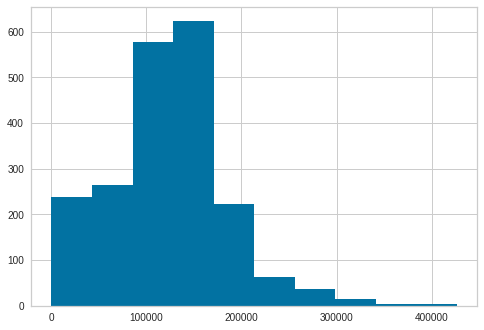

In [ ]:
df_small['km_lifetime'].hist()

In [ ]:
df_small['km_lifetime'].describe()


count      2046.000000
mean     122765.903226
std       60457.050953
min         326.000000
25%       87502.750000
50%      125757.000000
75%      152509.000000
max      426628.000000
Name: km_lifetime, dtype: float64

In [ ]:
df_small['days_driven']=df_small['end_date']-df_small['release']

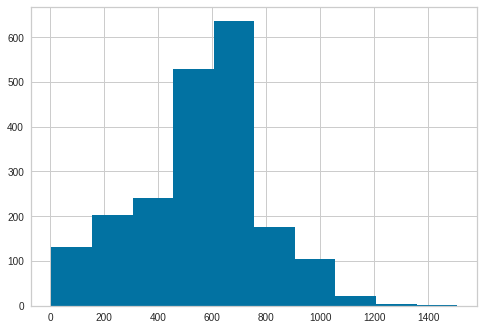

In [ ]:
df_small['days_driven'].dt.days.hist()

In [ ]:
df_small['days_driven'].describe()

count                           2046
mean     557 days 17:13:11.788856304
std      228 days 00:21:17.142203564
min                  4 days 00:00:00
25%                426 days 00:00:00
50%                591 days 00:00:00
75%                682 days 00:00:00
max               1507 days 00:00:00
Name: days_driven, dtype: object

In [ ]:
list(df_small)

['fin',
 'position number',
 'release',
 'end_date',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'approx_km',
 'no. Axles',
 'axle load type',
 'superstructure design',
 'brake diameter',
 'Total_Price',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'approx_km_end',
 'km_lifetime',
 'days_driven']

In [ ]:
df_small['tire_id']=df_small['fin'].astype(str)+"_"+df_small['position number'].astype(str)+"_"+df_small['release'].astype(str)
df_small.head()

,fin,position number,release,end_date,months_of_age,country of registration,tire price in eur,approx_km,no. Axles,axle load type,superstructure design,brake diameter,Total_Price,tire_width,aspect_ratio,tire_diameter,approx_km_end,km_lifetime,days_driven,tire_id
0,WKESD000000779112,2,2017-11-15,2018-11-05,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,151345.0,134756.0,355 days,WKESD000000779112_2_2017-11-15
1,WKESD000000779112,3,2017-11-15,2019-02-22,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,185575.0,168986.0,464 days,WKESD000000779112_3_2017-11-15
2,WKESD000000779112,4,2017-11-15,2019-02-22,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,185575.0,168986.0,464 days,WKESD000000779112_4_2017-11-15
3,WKESD000000779112,5,2017-11-15,2020-01-28,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,307486.0,290897.0,804 days,WKESD000000779112_5_2017-11-15
4,WKESD000000779112,6,2017-11-15,2018-11-05,3.0,Deutschland,500.91,16589.0,D dreiachs-,27 t,FB Fleischbahnen (Cool Liner),"430, Scheibendurchm. 22.5 Zoll",555.91,385.0,65.0,22.5,151345.0,134756.0,355 days,WKESD000000779112_6_2017-11-15


# Sensors Data

In [ ]:
sensor_path = '/content/drive/MyDrive/Colab Notebooks/KRONE/sensor_wide_final_new.csv'


In [ ]:
sensor=pd.read_csv(sensor_path)
sensor.head()


,Unnamed: 0,device_mongo_id,start_date,longitude,latitude,BD_GPS_HEIGHT_min,101_max,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,...,BD_EBS_BOOGIE_LOAD_avg,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg,173_avg,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum
0,0,57ac44610bc3dc434a8a4366,2017-03-23,11.1,53.3,0.0,0.0,5800.0,5800.0,13.0,...,11.862069,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,57ac44610bc3dc434a8a4366,2017-03-24,11.1,53.3,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,57ac44610bc3dc434a8a4366,2017-03-25,11.1,53.3,0.0,0.0,5900.0,5900.0,14.0,...,13.424242,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,57ac44610bc3dc434a8a4366,2017-03-26,11.1,53.3,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,57ac44610bc3dc434a8a4366,2017-03-27,11.1,53.3,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
#(2712927, 65)
#(7647009, 23)
sensor.shape

(2712927, 26)

In [ ]:
sensor.head()

,Unnamed: 0,device_mongo_id,start_date,longitude,latitude,BD_GPS_HEIGHT_min,101_max,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,...,BD_EBS_BOOGIE_LOAD_avg,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg,173_avg,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum
0,0,57ac44610bc3dc434a8a4366,2017-03-23,11.1,53.3,0.0,0.0,5800.0,5800.0,13.0,...,11.862069,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,57ac44610bc3dc434a8a4366,2017-03-24,11.1,53.3,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,57ac44610bc3dc434a8a4366,2017-03-25,11.1,53.3,0.0,0.0,5900.0,5900.0,14.0,...,13.424242,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,57ac44610bc3dc434a8a4366,2017-03-26,11.1,53.3,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,57ac44610bc3dc434a8a4366,2017-03-27,11.1,53.3,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
try:
  sensor.drop('Unnamed: 0',axis=1,inplace=True)
except:
  pass 

In [ ]:
list(sensor)

['device_mongo_id',
 'start_date',
 'longitude',
 'latitude',
 'BD_GPS_HEIGHT_min',
 '101_max',
 'BD_EBS_AXLE_LOAD_max',
 'BD_EBS_AXLE_LOAD_SUM_max',
 'BD_EBS_BOOGIE_LOAD_max',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max',
 'BD_GPS_HEIGHT_max',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max',
 'coupled_avg',
 'BD_EBS_AXLE_LOAD_avg',
 'BD_EBS_AXLE_LOAD_SUM_avg',
 'BD_EBS_BOOGIE_LOAD_avg',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg',
 '173_avg',
 'BD_GPS_HEIGHT_avg',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum',
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum']

In [ ]:
sensor_daily=sensor.groupby(['device_mongo_id','start_date']).agg({'BD_GPS_HEIGHT_min':'min',
 '101_max':'max',
 'BD_EBS_AXLE_LOAD_max':'max',
 'BD_EBS_AXLE_LOAD_SUM_max':'max',
 'BD_EBS_BOOGIE_LOAD_max':'max',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max':'max',
 'BD_GPS_HEIGHT_max':'max',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max':'max',
 'coupled_avg':'mean',
 'BD_EBS_AXLE_LOAD_avg':'mean',
 'BD_EBS_AXLE_LOAD_SUM_avg':'mean',
 'BD_EBS_BOOGIE_LOAD_avg':'mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg':'mean',
 '173_avg':'mean',
 'BD_GPS_HEIGHT_avg':'mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg':'mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum':'sum',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum':'sum',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum':'sum',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum':'sum',
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum':'sum'})

In [ ]:
sensor_daily.reset_index(inplace=True)

In [ ]:
sensor_daily.describe()

,BD_GPS_HEIGHT_min,101_max,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,BD_EBS_AVERAGE_BRAKE_PRESSURE_max,BD_GPS_HEIGHT_max,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max,coupled_avg,BD_EBS_AXLE_LOAD_avg,...,BD_EBS_BOOGIE_LOAD_avg,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg,173_avg,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum
count,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,...,2.099697e+06,2.099697e+06,2099697.0,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06,2.099697e+06
mean,5.765225e+01,1.736223e+08,1.108119e+04,1.250668e+04,4.445354e+01,7.004588e+01,2.212165e+02,5.262285e+01,3.123713e-01,6.221089e+03,...,2.275954e+01,1.060554e+01,0.0,1.075954e+02,1.015541e+01,7.820758e+04,1.287324e-01,1.071580e+02,9.852451e+01,6.571132e+02
std,1.262954e+02,1.077884e+09,8.802352e+03,8.805927e+03,3.416467e+01,2.230031e+02,2.586309e+02,4.278182e+01,3.539815e-01,5.997881e+03,...,2.016782e+01,3.704437e+01,0.0,1.368381e+02,1.355875e+01,1.132261e+07,4.015576e+00,2.824091e+02,1.198716e+03,2.020622e+04
min,-1.100000e+03,-2.147440e+09,-3.300000e+04,0.000000e+00,0.000000e+00,0.000000e+00,-1.098000e+03,0.000000e+00,0.000000e+00,-3.300000e+04,...,0.000000e+00,0.000000e+00,0.0,-1.098000e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,0.000000e+00,-4.197191e+08,0.000000e+00,6.100000e+03,1.300000e+01,0.000000e+00,5.900000e+01,0.000000e+00,0.000000e+00,0.000000e+00,...,6.841772e+00,0.000000e+00,0.0,2.536364e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.000000e+01,0.000000e+00,1.080000e+04,1.340000e+04,4.500000e+01,1.200000e+01,1.110000e+02,8.300000e+01,1.666667e-01,5.860820e+03,...,1.983333e+01,4.447183e+00,0.0,5.193130e+01,4.864865e+00,5.000000e+00,0.000000e+00,7.100000e+01,0.000000e+00,5.000000e+00
75%,6.300000e+01,9.868299e+08,1.840000e+04,1.990000e+04,7.300000e+01,3.500000e+01,3.320000e+02,8.800000e+01,5.131579e-01,9.604167e+03,...,3.287619e+01,1.000000e+01,0.0,1.350000e+02,1.500000e+01,1.500000e+02,0.000000e+00,1.350000e+02,0.000000e+00,4.120000e+02
max,1.004000e+04,2.147483e+09,4.740000e+04,4.780000e+04,2.550000e+02,8.987000e+03,1.209300e+04,1.410000e+02,1.000000e+00,3.970000e+04,...,1.510000e+02,1.279000e+03,0.0,1.004000e+04,9.800000e+01,6.026930e+09,3.053000e+03,4.160400e+04,6.452960e+05,1.171159e+07


In [ ]:
sensor_daily.drop('173_avg',axis=1,inplace=True)

In [ ]:
sensor_daily.rename(columns={'101_max':"duration_driving_max"},inplace=True)

In [ ]:
sensor_daily.drop("duration_driving_max",axis=1,inplace=True)

In [ ]:
sensor_daily['GPS_delta']=	sensor_daily['BD_GPS_HEIGHT_max']-sensor_daily['BD_GPS_HEIGHT_min']

In [ ]:
sensor_daily.head()

,device_mongo_id,start_date,BD_GPS_HEIGHT_min,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,BD_EBS_AVERAGE_BRAKE_PRESSURE_max,BD_GPS_HEIGHT_max,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max,coupled_avg,...,BD_EBS_BOOGIE_LOAD_avg,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum,GPS_delta
0,57ac44610bc3dc434a8a4366,2017-03-23,0.0,5800.0,5800.0,13.0,0.0,0.0,0.0,0.240385,...,11.862069,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,57ac44610bc3dc434a8a4366,2017-03-24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,57ac44610bc3dc434a8a4366,2017-03-25,0.0,5900.0,5900.0,14.0,0.0,0.0,0.0,0.203008,...,13.424242,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,57ac44610bc3dc434a8a4366,2017-03-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,57ac44610bc3dc434a8a4366,2017-03-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
import gc

del sensor

gc.collect()

307

In [ ]:
# Reading the serials data
serial_path = "/content/drive/MyDrive/Colab Notebooks/KRONE/serial.xlsx"
serial = pd.read_excel(serial_path)
serial.head()


,FIN,FIN2,Identifier,MongoID
0,WKESD000000898165,F0898165,16339,62f0f724e4b03b515e4f1a9f
1,WKESD000000898166,F0898166,16156,62f0d1f2e4b03b515e4f1a9a
2,WKESD000000967776,F0967776,1005111,622995f9e4b040fb84803952
3,WKESD000001006285,F1006285,1002366,6202142fe4b040fb848034c3
4,WKESD000001027402,F1027402,33451,61724677e4b03dbd5a1821ad


In [ ]:
serial_=serial[['FIN','MongoID']]
serial_=serial_[serial_['MongoID'].notnull()]

In [ ]:
fin_to_remove=['WKESD000000867904',
 'WKESD000000867905',
 'WKESD000000759887']

In [ ]:
serial_=serial_[~serial_['FIN'].isin(fin_to_remove)]

In [ ]:
sensor_=pd.merge(sensor_daily,serial_,left_on='device_mongo_id',right_on='MongoID')
sensor_

,device_mongo_id,start_date,BD_GPS_HEIGHT_min,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,BD_EBS_AVERAGE_BRAKE_PRESSURE_max,BD_GPS_HEIGHT_max,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max,coupled_avg,...,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum,GPS_delta,FIN,MongoID
0,57ac44610bc3dc434a8a4366,2017-03-23,0.0,5800.0,5800.0,13.0,0.0,0.0,0.0,0.240385,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557,57ac44610bc3dc434a8a4366
1,57ac44610bc3dc434a8a4366,2017-03-24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557,57ac44610bc3dc434a8a4366
2,57ac44610bc3dc434a8a4366,2017-03-25,0.0,5900.0,5900.0,14.0,0.0,0.0,0.0,0.203008,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557,57ac44610bc3dc434a8a4366
3,57ac44610bc3dc434a8a4366,2017-03-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557,57ac44610bc3dc434a8a4366
4,57ac44610bc3dc434a8a4366,2017-03-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557,57ac44610bc3dc434a8a4366
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2099664,622995f9e4b040fb84803952,2022-03-21,-48.0,7900.0,7900.0,22.0,0.0,-48.0,1.0,0.500000,...,-48.000000,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,WKESD000000967776,622995f9e4b040fb84803952
2099665,62f0d1f2e4b03b515e4f1a9a,2022-08-08,151.0,12542.0,12542.0,0.0,15.0,248.0,87.0,0.823529,...,201.500000,36.413793,0.0,0.0,29.0,0.0,0.0,97.0,WKESD000000898166,62f0d1f2e4b03b515e4f1a9a
2099666,62f0f724e4b03b515e4f1a9f,2022-08-17,23.0,8988.0,8988.0,0.0,60.0,773.0,88.0,0.712121,...,216.600000,46.716981,0.0,0.0,47.0,0.0,0.0,750.0,WKESD000000898165,62f0f724e4b03b515e4f1a9f
2099667,62f0f724e4b03b515e4f1a9f,2022-08-18,-15.0,16572.0,16572.0,0.0,47.0,199.0,86.0,0.362069,...,14.342593,20.988889,11.0,0.0,43.0,0.0,0.0,214.0,WKESD000000898165,62f0f724e4b03b515e4f1a9f


In [ ]:
sensor_.drop('MongoID',axis=1,inplace=True)

In [ ]:
sensor_.head(20)

,device_mongo_id,start_date,BD_GPS_HEIGHT_min,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,BD_EBS_AVERAGE_BRAKE_PRESSURE_max,BD_GPS_HEIGHT_max,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max,coupled_avg,...,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum,GPS_delta,FIN
0,57ac44610bc3dc434a8a4366,2017-03-23,0.0,5800.0,5800.0,13.0,0.0,0.0,0.0,0.240385,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
1,57ac44610bc3dc434a8a4366,2017-03-24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
2,57ac44610bc3dc434a8a4366,2017-03-25,0.0,5900.0,5900.0,14.0,0.0,0.0,0.0,0.203008,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
3,57ac44610bc3dc434a8a4366,2017-03-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
4,57ac44610bc3dc434a8a4366,2017-03-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
5,57ac44610bc3dc434a8a4366,2017-06-22,285.0,0.0,0.0,0.0,0.0,285.0,0.0,0.000000,...,0.0,285.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
6,57ac44610bc3dc434a8a4366,2017-07-07,-95.0,6700.0,6700.0,17.0,0.0,-6.0,1.0,0.666667,...,0.0,-60.857143,1.0,0.0,0.0,0.0,0.0,0.0,89.0,WKESD000000778557
7,57ac44610bc3dc434a8a4366,2017-07-08,-131.0,0.0,0.0,0.0,0.0,-131.0,0.0,0.000000,...,0.0,-131.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
8,57ac44610bc3dc434a8a4366,2017-07-09,84.0,0.0,0.0,0.0,0.0,84.0,0.0,0.000000,...,0.0,84.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
9,57ac44610bc3dc434a8a4366,2017-07-10,56.0,0.0,0.0,0.0,0.0,56.0,0.0,0.000000,...,0.0,56.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557


In [ ]:
sensor_['start_date']=pd.to_datetime(sensor_['start_date'],yearfirst=True)
sensor_.head(20)

,device_mongo_id,start_date,BD_GPS_HEIGHT_min,BD_EBS_AXLE_LOAD_max,BD_EBS_AXLE_LOAD_SUM_max,BD_EBS_BOOGIE_LOAD_max,BD_EBS_AVERAGE_BRAKE_PRESSURE_max,BD_GPS_HEIGHT_max,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max,coupled_avg,...,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg,BD_GPS_HEIGHT_avg,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg,BD_EBS_NUMBER_OF_ABS_EVENTS_sum,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum,GPS_delta,FIN
0,57ac44610bc3dc434a8a4366,2017-03-23,0.0,5800.0,5800.0,13.0,0.0,0.0,0.0,0.240385,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
1,57ac44610bc3dc434a8a4366,2017-03-24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
2,57ac44610bc3dc434a8a4366,2017-03-25,0.0,5900.0,5900.0,14.0,0.0,0.0,0.0,0.203008,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
3,57ac44610bc3dc434a8a4366,2017-03-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
4,57ac44610bc3dc434a8a4366,2017-03-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
5,57ac44610bc3dc434a8a4366,2017-06-22,285.0,0.0,0.0,0.0,0.0,285.0,0.0,0.000000,...,0.0,285.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
6,57ac44610bc3dc434a8a4366,2017-07-07,-95.0,6700.0,6700.0,17.0,0.0,-6.0,1.0,0.666667,...,0.0,-60.857143,1.0,0.0,0.0,0.0,0.0,0.0,89.0,WKESD000000778557
7,57ac44610bc3dc434a8a4366,2017-07-08,-131.0,0.0,0.0,0.0,0.0,-131.0,0.0,0.000000,...,0.0,-131.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
8,57ac44610bc3dc434a8a4366,2017-07-09,84.0,0.0,0.0,0.0,0.0,84.0,0.0,0.000000,...,0.0,84.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557
9,57ac44610bc3dc434a8a4366,2017-07-10,56.0,0.0,0.0,0.0,0.0,56.0,0.0,0.000000,...,0.0,56.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,WKESD000000778557


# Sensor variables to lifetime

In [ ]:
#EBS OVERLOAD missing
#continous behaviour vs one-off event

agg_logic={'GPS_delta':['mean'],
 #'duration_driving_max':['mean'],
 'BD_EBS_AXLE_LOAD_max':['mean'],
 'BD_EBS_AXLE_LOAD_SUM_max':['mean'],
 'BD_EBS_BOOGIE_LOAD_max':['mean'],
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max':['mean'],
 #'BD_GPS_HEIGHT_max':'max',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max':['mean'],
 'coupled_avg':['mean'],
 'BD_EBS_AXLE_LOAD_avg':['mean'],
 'BD_EBS_AXLE_LOAD_SUM_avg':['mean'],
 'BD_EBS_BOOGIE_LOAD_avg':['mean'],
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg':['mean'],
 'BD_GPS_HEIGHT_avg':['mean'],
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg':['mean'],
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum':['mean'],
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum':['mean'],
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum':['mean'],
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum':['mean'],
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum':['mean']}

In [ ]:
life_agg_cols=['GPS_delta_mean',
 #'duration_driving_max_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean',
 'lifetime_id']

In [ ]:
fin='WKESD000000779112'
release=pd.to_datetime('2017-11-15')
end_date=pd.to_datetime('2020-01-28')

temp=sensor_.loc[sensor_['FIN']==fin]
temp=temp[(temp['start_date']>=release) & (temp['start_date']<=end_date)]
temp=pd.DataFrame(temp.groupby('FIN').agg(agg_logic))
a=temp.columns.get_level_values(0).tolist()
b=temp.columns.get_level_values(1).tolist()
temp.columns=[m+"_"+n for m,n in zip(a,b)]
temp.reset_index(inplace=True)
temp['release']=release
temp['end_date']=end_date
temp['fin']=fin
temp['lifetime_id']=temp['release'].astype(str)+"_"+temp['end_date'].astype(str)+"_"+temp['fin'].astype(str)
# temp.reset_index(inplace=True)
temp.drop(['FIN','release','end_date','fin'],axis=1,inplace=True)
list(temp)


# #temp.head()
#   # if len(temp)>0:
#   #   temp.groupby('FIN')[metric_cols].mean()
#   # else:



['GPS_delta_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean',
 'lifetime_id']

In [ ]:
len(list(temp))

19

In [ ]:
temp.head()

,GPS_delta_mean,BD_EBS_AXLE_LOAD_max_mean,BD_EBS_AXLE_LOAD_SUM_max_mean,BD_EBS_BOOGIE_LOAD_max_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean,coupled_avg_mean,BD_EBS_AXLE_LOAD_avg_mean,BD_EBS_AXLE_LOAD_SUM_avg_mean,BD_EBS_BOOGIE_LOAD_avg_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean,BD_GPS_HEIGHT_avg_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean,BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean,lifetime_id
0,231.49354,15381.007752,15592.118863,54.152455,154.094315,65.034884,0.344008,8844.727299,8992.875447,26.917565,11.167917,87.009066,10.902269,333.011628,0.0,86.273902,0.0,879.31137,2017-11-15_2020-01-28_WKESD000000779112


In [ ]:
# postision in lifetime id
def sensors_assign(fin,release,end_date,):
  temp=sensor_.loc[sensor_['FIN']==fin]
  temp=temp[(temp['start_date']>=release) & (temp['start_date']<=end_date)]
  if len(temp)>0:
    temp=sensor_.loc[sensor_['FIN']==fin]
    temp=temp[(temp['start_date']>=release) & (temp['start_date']<=end_date)]
    temp=pd.DataFrame(temp.groupby('FIN').agg(agg_logic))
    a=temp.columns.get_level_values(0).tolist()
    b=temp.columns.get_level_values(1).tolist()
    temp.columns=[m+"_"+n for m,n in zip(a,b)]
    temp.reset_index(inplace=True)
    temp['release']=release
    temp['end_date']=end_date
    temp['fin']=fin
    temp['lifetime_id']=temp['release'].astype(str)+"_"+temp['end_date'].astype(str)+"_"+temp['fin'].astype(str)
    temp.drop(['FIN','release','end_date','fin'],axis=1,inplace=True)
    return temp.values.tolist()[0]
  else:
    a=[np.nan] * 19
    return a


In [ ]:
applied_df=df_small.apply(lambda x: sensors_assign(x.fin,x.release,x.end_date), axis='columns',result_type='expand')
applied_df.columns=life_agg_cols
applied_df

,GPS_delta_mean,BD_EBS_AXLE_LOAD_max_mean,BD_EBS_AXLE_LOAD_SUM_max_mean,BD_EBS_BOOGIE_LOAD_max_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean,coupled_avg_mean,BD_EBS_AXLE_LOAD_avg_mean,BD_EBS_AXLE_LOAD_SUM_avg_mean,BD_EBS_BOOGIE_LOAD_avg_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean,BD_GPS_HEIGHT_avg_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean,BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean,lifetime_id
0,173.258359,16322.796353,16819.452888,59.598784,117.744681,71.191489,0.272941,8869.488878,9218.019780,28.695345,11.122255,67.915001,10.882025,150.012158,0.0,85.817629,0.0,776.881459,2017-11-15_2018-11-05_WKESD000000779112
1,195.465438,15076.497696,15452.995392,54.366359,136.880184,66.596774,0.321885,8515.658525,8779.867435,26.905240,10.798034,81.567686,11.728983,133.947005,0.0,76.142857,0.0,672.172811,2017-11-15_2019-02-22_WKESD000000779112
2,195.465438,15076.497696,15452.995392,54.366359,136.880184,66.596774,0.321885,8515.658525,8779.867435,26.905240,10.798034,81.567686,11.728983,133.947005,0.0,76.142857,0.0,672.172811,2017-11-15_2019-02-22_WKESD000000779112
3,231.493540,15381.007752,15592.118863,54.152455,154.094315,65.034884,0.344008,8844.727299,8992.875447,26.917565,11.167917,87.009066,10.902269,333.011628,0.0,86.273902,0.0,879.311370,2017-11-15_2020-01-28_WKESD000000779112
4,173.258359,16322.796353,16819.452888,59.598784,117.744681,71.191489,0.272941,8869.488878,9218.019780,28.695345,11.122255,67.915001,10.882025,150.012158,0.0,85.817629,0.0,776.881459,2017-11-15_2018-11-05_WKESD000000779112
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2195,222.181818,14989.090909,14989.090909,69.436364,10.754545,77.636364,0.725504,8180.986408,8180.986408,29.274557,6.430796,253.924047,12.737648,453.372727,0.0,141.154545,0.0,10.954545,2021-11-15_2022-07-07_WKESD000000934720
2196,222.181818,14989.090909,14989.090909,69.436364,10.754545,77.636364,0.725504,8180.986408,8180.986408,29.274557,6.430796,253.924047,12.737648,453.372727,0.0,141.154545,0.0,10.954545,2021-11-15_2022-07-07_WKESD000000934720
2198,51.561798,23339.168539,23339.168539,98.044944,458.056180,82.337079,0.319253,7554.539244,7554.539244,28.964099,13.673836,19.632028,4.376787,17.168539,0.0,191.348315,0.0,0.719101,2021-11-29_2022-05-13_WKESD000000917032
2199,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
applied_df.shape

(2046, 19)

In [ ]:
df_small.shape

(2046, 20)

In [ ]:
df_int=pd.concat([df_small,applied_df], axis=1)

In [ ]:
df_int.isnull().sum()/len(df_int)

fin                                                  0.000000
position number                                      0.000000
release                                              0.000000
end_date                                             0.000000
months_of_age                                        0.000000
country of registration                              0.000000
tire price in eur                                    0.000000
approx_km                                            0.000000
no. Axles                                            0.000000
axle load type                                       0.000000
superstructure design                                0.000000
brake diameter                                       0.000000
Total_Price                                          0.000000
tire_width                                           0.000000
aspect_ratio                                         0.000000
tire_diameter                                        0.000000
approx_k

In [ ]:
df_int.dropna(inplace=True)

In [ ]:
df_int.shape

(2032, 39)

In [ ]:
list(df_int)

['fin',
 'position number',
 'release',
 'end_date',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'approx_km',
 'no. Axles',
 'axle load type',
 'superstructure design',
 'brake diameter',
 'Total_Price',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'approx_km_end',
 'km_lifetime',
 'days_driven',
 'tire_id',
 'GPS_delta_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_PARKI

In [ ]:
drop_cols=['lifetime_id','fin','release','end_date','approx_km','Total_Price','approx_km_end']
df_int.drop(drop_cols,inplace=True,axis=1)

In [ ]:
df_int['days_driven']=df_int['days_driven'].apply(lambda x: int(str(x).split()[0]))


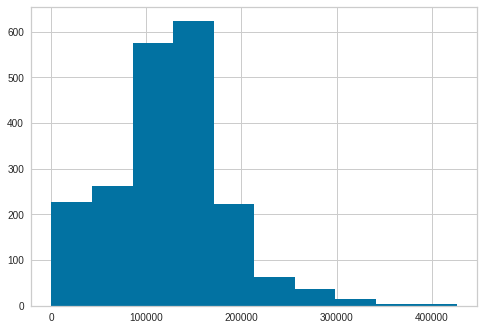

In [ ]:
df_int['km_lifetime'].hist()

In [ ]:
df_int['km_lifetime'].describe()

count      2032.000000
mean     123427.982283
std       60075.887157
min         326.000000
25%       89061.000000
50%      126379.500000
75%      152852.500000
max      426628.000000
Name: km_lifetime, dtype: float64

In [ ]:
temp=df_int['km_lifetime']

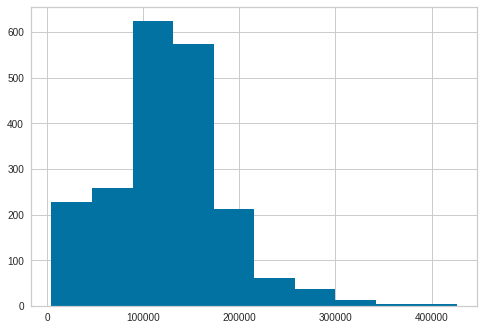

In [ ]:
from scipy import stats
df_int['km_lifetime'][(stats.zscore(df_int['km_lifetime']) >-2)].hist()

In [ ]:
df_int=df_int[(stats.zscore(df_int['km_lifetime']) >-2)]

In [ ]:
#df_int['avg_daily_lifetime_km']=df_int['km_lifetime']/df_int['days_driven']

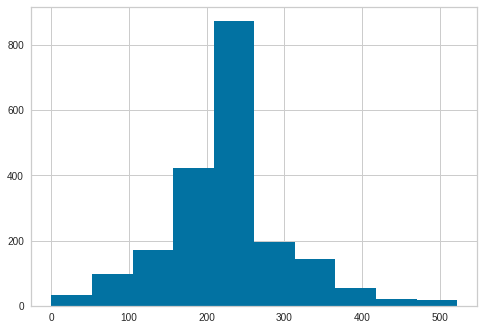

In [ ]:
#df_int['avg_daily_lifetime_km'].hist()

In [ ]:
df_int.to_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/final_df_model.csv')

# Machine Learning

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/final_df_model.csv')

In [ ]:
#data=df_int.copy()

In [ ]:
list(data)

['Unnamed: 0',
 'position number',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'no. Axles',
 'axle load type',
 'superstructure design',
 'brake diameter',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'km_lifetime',
 'days_driven',
 'tire_id',
 'GPS_delta_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean']

In [ ]:
try:
  data.drop('Unnamed: 0',axis=1,inplace=True)
except:
  pass 

In [ ]:
data['days_driven']=data['days_driven'].apply(lambda x: int(str(x).split()[0]))


In [ ]:
#data['utilization']=(data['km_lifetime']-data['km_lifetime'].mean())/data['km_lifetime']

In [ ]:
all_cols=list(data)
cat_columns=['position number',
             'country of registration',
'superstructure design',                              
'no. Axles',
'axle load type',
'brake diameter',
'tire_id']
num_cols = [cols for cols in all_cols if cols not in cat_columns]


In [ ]:
!pip install sweetviz


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
data[cat_columns]=data[cat_columns].astype('str')
data[num_cols]=data[num_cols].astype('float32')

In [ ]:
import sweetviz as sv
feature_config = sv.FeatureConfig(skip='tire_id', force_text=cat_columns)


In [ ]:
analyze_report=sv.analyze(data,'km_lifetime',feature_config)

                                             |          | [  0%]   00:00 -> (? left)

In [ ]:
# EDA Report
analyze_report.show_html('ML_KRONE.html', open_browser=False)

Report ML_KRONE.html was generated.


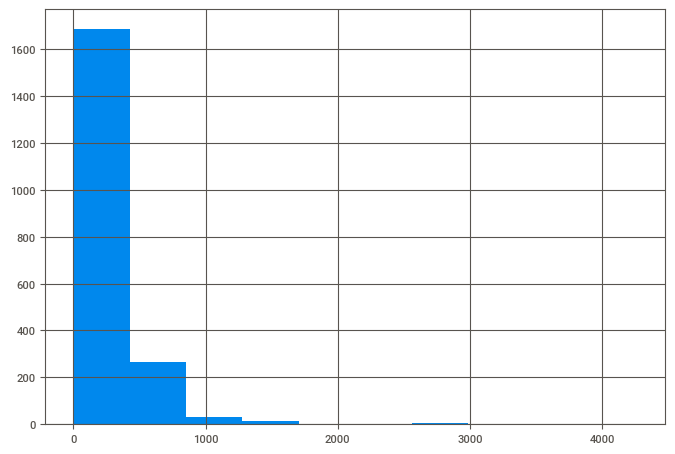

In [ ]:
data['BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean'][(stats.zscore(data['BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean'])<0.5)].hist()

In [ ]:
data['BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean'][(stats.zscore(data['BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean'])<1)].describe()

count    2010.000000
mean      263.791656
std       310.456177
min         0.000000
25%        75.677017
50%       205.209442
75%       375.112122
max      4264.954102
Name: BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean, dtype: float64

In [ ]:
data.shape

(2010, 32)

In [ ]:
!pip install stats

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 127 kB 14.3 MB/s 
  Created wheel for stats: filename=stats-0.1.2a0-py3-none-any.whl size=24299 sha256=4b4cb0347c5b6870171fb8a9c46f1a69f2294074217225f1994f052446cc3705
  Stored in directory: /root/.cache/pip/wheels/e3/1c/58/620049eecc13fb5b4920470895e07a39f86e889a0a58b11976
Successfully built stats


In [ ]:
from scipy import stats
data=data[(stats.zscore(data['BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean'])<1)]

In [ ]:
data.drop('BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean',axis=1,inplace=True)

In [ ]:
list(data)

['position number',
 'months_of_age',
 'country of registration',
 'tire price in eur',
 'no. Axles',
 'axle load type',
 'superstructure design',
 'brake diameter',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'km_lifetime',
 'days_driven',
 'tire_id',
 'GPS_delta_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean']

In [ ]:
s = setup(data, target = 'km_lifetime', ignore_features = ['days_driven','tire_id','tire price in eur','position number'],
          categorical_features=cat_columns,train_size=0.8
          ,
          #profile=True,
          #normalize = True, transformation = True, transform_target = True,
          #combine_rare_levels = True, rare_level_threshold = 0.05,

          remove_multicollinearity = True, multicollinearity_threshold = 0.95
          ,session_id=19
          )

,Description,Value
0,session_id,19
1,Target,km_lifetime
2,Original Data,"(2010, 31)"
3,Missing Values,False
4,Numeric Features,19
5,Categorical Features,7
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(1608, 35)"


INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['country of '
                                                            'registration',
                                                            'superstructure '
                                                            'design',
                                                            'no. Axles',
                                                            'axle load type',
                                                            'brake diameter'],
                                      display_types=True,
                                      features_todrop=['days_driven', 'tire_id',
                                                       'tire price in eur',
                                                       'position number'],
                    

In [ ]:
models = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,1.732142e+04,1.216189e+09,3.461398e+04,6.454000e-01,0.4418,0.3739,0.873
rf,Random Forest Regressor,2.279488e+04,1.415249e+09,3.733693e+04,5.883000e-01,0.4772,0.4589,1.878
lightgbm,Light Gradient Boosting Machine,2.335039e+04,1.463124e+09,3.795077e+04,5.740000e-01,0.4669,0.4350,0.250
gbr,Gradient Boosting Regressor,3.005546e+04,1.865485e+09,4.306419e+04,4.547000e-01,0.5289,0.5410,0.547
dt,Decision Tree Regressor,2.311519e+04,2.255643e+09,4.706418e+04,3.436000e-01,0.5390,0.4437,0.038
ada,AdaBoost Regressor,3.834832e+04,2.647690e+09,5.139997e+04,2.255000e-01,0.6233,0.7441,0.220
ridge,Ridge Regression,3.923639e+04,2.803945e+09,5.288845e+04,1.772000e-01,0.6095,0.7137,0.014
llar,Lasso Least Angle Regression,3.926612e+04,2.808073e+09,5.292662e+04,1.759000e-01,0.6100,0.7128,0.023
lasso,Lasso Regression,3.933056e+04,2.810257e+09,5.294445e+04,1.752000e-01,0.6113,0.7144,0.031
lr,Linear Regression,3.934586e+04,2.816217e+09,5.299923e+04,1.734000e-01,0.6143,0.7151,0.350


INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=19, verbose=0, warm_start=False)
INFO:logs:compare_models() succesfully completed......................................


In [ ]:
best_model=create_model('rf')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,22792.9296,1.473981e+09,38392.4610,0.5392,0.4725,0.4402
1,22778.8360,1.439756e+09,37944.1167,0.5937,0.5145,0.4857
2,22175.2400,1.238573e+09,35193.3713,0.6344,0.4609,0.4411
3,19823.1126,1.004447e+09,31693.0162,0.6675,0.3419,0.2602
4,19932.6871,9.898948e+08,31462.5939,0.7063,0.4134,0.3572
5,23500.8045,1.400121e+09,37418.1851,0.5748,0.5087,0.5212
6,23666.3878,1.473933e+09,38391.8344,0.6065,0.5190,0.5399
7,22561.9453,1.805679e+09,42493.2822,0.5248,0.5039,0.4796
8,28742.1118,2.218795e+09,47104.0862,0.3618,0.5958,0.6691


INFO:logs:create_model_container: 21
INFO:logs:master_model_container: 21
INFO:logs:display_container: 5
INFO:logs:RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=19, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................


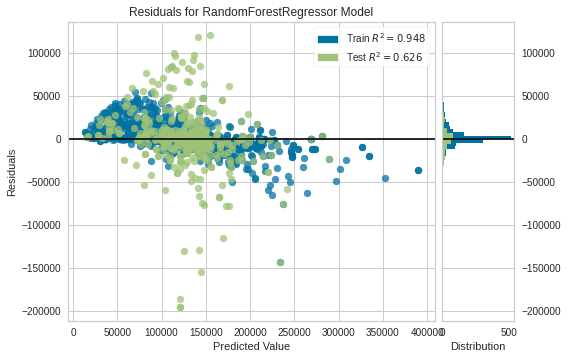

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
# Residual Plot
plot_model(best_model)


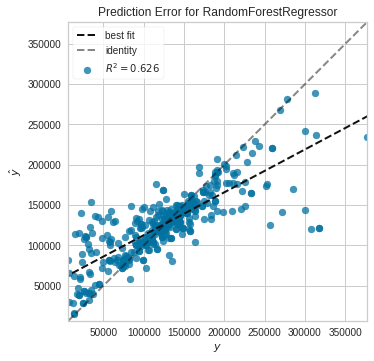

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(best_model, plot = 'error')


In [ ]:
#tuned_best_model = tune_model(best_model)


In [ ]:
# Residual Plot
#plot_model(tuned_best_model)

In [ ]:
#plot_model(tuned_best_model, plot = 'error')


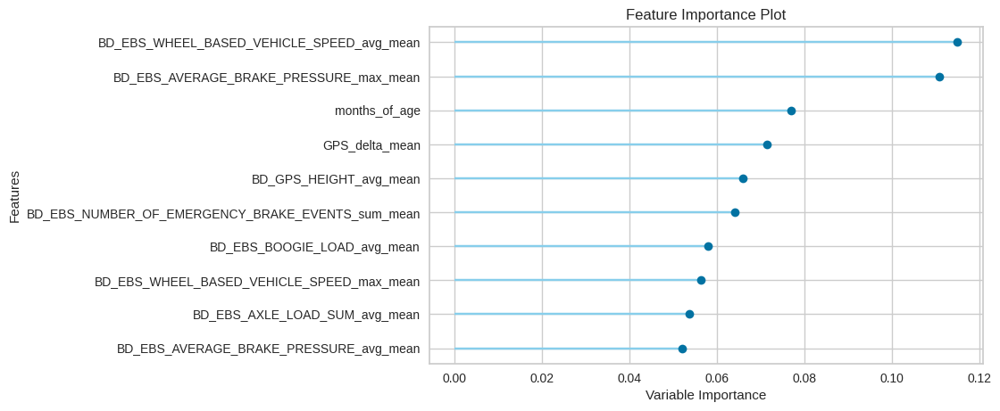

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(best_model, plot='feature')


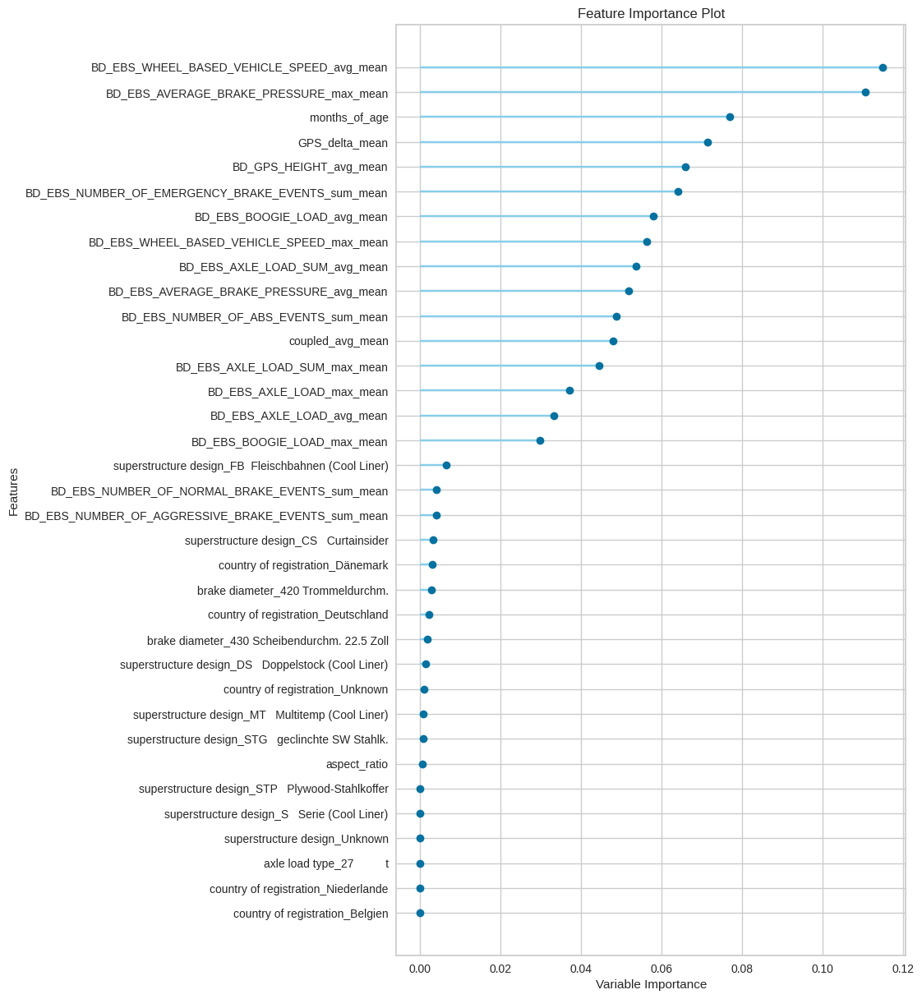

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(best_model, plot='feature_all')

In [ ]:
# interpret model
!pip install numba==0.53
!pip install shap
import shap


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


INFO:logs:Initializing interpret_model()
INFO:logs:interpret_model(estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=19, verbose=0, warm_start=False), use_train_data=False, X_new_sample=None, y_new_sample=None, feature=None, kwargs={}, observation=None, plot=summary, save=False)
INFO:logs:Checking exceptions
INFO:logs:plot type: summary
INFO:logs:Creating TreeExplainer
INFO:logs:Compiling shap values


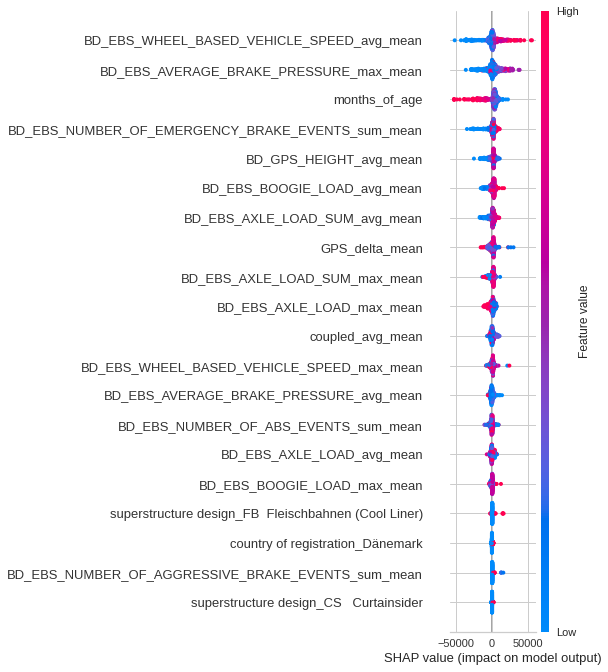

INFO:logs:Visual Rendered Successfully
INFO:logs:interpret_model() succesfully completed......................................


In [ ]:
interpret_model(best_model)

In [ ]:
predict_model(best_model)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=19, verbose=0, warm_start=False), probability_threshold=None, encoded_labels=True, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.REGRESSION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Random Forest Regressor,22505.4915,1.401905e+09,37442.0155,0.6257,0.4368,0.3758


,months_of_age,aspect_ratio,GPS_delta_mean,BD_EBS_AXLE_LOAD_max_mean,BD_EBS_AXLE_LOAD_SUM_max_mean,BD_EBS_BOOGIE_LOAD_max_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean,coupled_avg_mean,BD_EBS_AXLE_LOAD_avg_mean,...,superstructure design_FB Fleischbahnen (Cool Liner),superstructure design_MT Multitemp (Cool Liner),superstructure design_S Serie (Cool Liner),superstructure design_STG geclinchte SW Stahlk.,superstructure design_STP Plywood-Stahlkoffer,superstructure design_Unknown,brake diameter_420 Trommeldurchm.,brake diameter_430 Scheibendurchm. 22.5 Zoll,km_lifetime,Label
0,21.0,65.0,605.549011,18917.718750,18917.718750,90.423203,75.037582,87.875816,0.305707,6006.607910,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,313219.0,236875.73
1,34.0,65.0,157.516785,8404.647461,12760.738281,44.489933,9.651007,48.681210,0.644259,1693.610840,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,24398.0,28303.66
2,18.0,65.0,228.139816,7345.106445,14786.625977,51.112461,42.527355,56.264439,0.095938,2124.302002,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,128697.0,127400.56
3,23.0,65.0,254.164780,15695.034180,15695.034180,53.650112,30.187359,63.029346,0.174184,9371.561523,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,97073.0,126294.06
4,6.0,65.0,56.270386,8177.682617,8177.682617,28.450644,30.317596,38.854076,0.345447,4442.356445,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,25958.0,43974.68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397,21.0,65.0,81.812256,12189.920898,12189.920898,42.098816,56.357708,36.873516,0.147441,8087.217285,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,73466.0,71725.85
398,6.0,65.0,88.174004,10587.001953,10587.001953,35.712788,73.318657,64.685532,0.399921,4759.542969,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,131372.0,109641.21
399,25.0,65.0,210.846802,8032.501953,16136.312500,56.127659,31.696453,58.804256,0.172511,3059.861084,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,143221.0,128893.17
400,21.0,65.0,32.384735,8317.405273,8317.405273,40.266354,51.883179,46.487537,0.141683,5746.306641,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,74598.0,76832.30


# Prediction on customer dataset

In [ ]:
final_model = finalize_model(best_model)


INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=19, verbose=0, warm_start=False), fit_kwargs=None, groups=None, model_only=True, display=None, experiment_custom_tags=None, return_train_score=False)
INFO:logs:Finalizing RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
          

In [ ]:
# Reading the customer data
cust_path = "/content/drive/MyDrive/Colab Notebooks/KRONE/rental_contracts.csv"
cust_df=pd.read_csv(cust_path,engine='python',encoding='latin-1')
cust_df.head()


,Landesgesellschaft,Flottennummer,Fahrgestellnummer,Artikelgruppe,Name Artikelgruppe,Auftragsnummer,Debitorennummer,Agreement_items_names,Region,Street_house_number,zip_city,Datum Mietbeginn,Datum Mietende,Aktiv
0,KFDE,K9N3,W0590951,1-4-01-01,Swap Curtain Basic,18512,1000625,Schenker & CO AG Zentrale Österreich,AUT,Stella-Klein-Löw-Weg 11,1020 Wien,02-12-2013,21-04-2020,Beendet
1,KFDE,N5R9,W0590916,1-4-01-01,Swap Curtain Basic,18133,1000625,Schenker & CO AG Zentrale Österreich,AUT,Stella-Klein-Löw-Weg 11,1020 Wien,04-10-2013,03-10-2019,Beendet
2,KFDE,W8H5,W0590915,1-4-01-01,Swap Curtain Basic,18132,1000625,Schenker & CO AG Zentrale Österreich,AUT,Stella-Klein-Löw-Weg 11,1020 Wien,04-10-2013,28-02-2020,Beendet
3,KFDE,H7S4,W0590926,1-4-01-01,Swap Curtain Basic,18199,1000625,Schenker & CO AG Zentrale Österreich,AUT,Stella-Klein-Löw-Weg 11,1020 Wien,07-10-2013,02-03-2020,Beendet
4,KFDE,U5J6,W0590917,1-4-01-01,Swap Curtain Basic,18134,1000625,Schenker & CO AG Zentrale Österreich,AUT,Stella-Klein-Löw-Weg 11,1020 Wien,07-10-2013,06-10-2019,Beendet


In [ ]:
list(cust_df)

['Landesgesellschaft',
 'Flottennummer',
 'Fahrgestellnummer',
 'Artikelgruppe',
 'Name Artikelgruppe',
 'Auftragsnummer',
 'Debitorennummer',
 'Agreement_items_names',
 'Region',
 'Street_house_number',
 'zip_city',
 'Datum Mietbeginn',
 'Datum Mietende ',
 'Aktiv']

In [ ]:
cust_df.columns=['national company',
  'fleet number',
  'VIN',
  'article group',
  'Name item group',
  'Order number',
  'Customer number',
  'Agreement_items_names',
  'Region',
  'Street_house_number',
  'zip_city',
  'Rental start date',
  'Rate end date',
  'Active']

In [ ]:
cust_cols=[
  'VIN',
  'Customer number',
  'Region',
  'Rental start date',
  'Rate end date']
cust=cust_df[cust_cols]

In [ ]:
cust.drop_duplicates(inplace=True)

In [ ]:
cust.head()

,VIN,Customer number,Region,Rental start date,Rate end date
0,W0590951,1000625,AUT,02-12-2013,21-04-2020
1,W0590916,1000625,AUT,04-10-2013,03-10-2019
2,W0590915,1000625,AUT,04-10-2013,28-02-2020
3,W0590926,1000625,AUT,07-10-2013,02-03-2020
4,W0590917,1000625,AUT,07-10-2013,06-10-2019


0

In [ ]:
cust['Rental start date']=pd.to_datetime(cust['Rental start date'],dayfirst=True)
cust['Rate end date']=pd.to_datetime(cust['Rate end date'],dayfirst=True)

In [ ]:
cust['Region'].value_counts()

DEU    16716
NLD    10761
DNK     9232
ESP     5539
FRA     3230
BEL     3053
NOR     2154
ROU      339
GBR      311
HUN      276
FRO      240
AUT      238
POL      159
LTU      120
BGR       85
SWE       71
LUX       55
CHE       34
FIN       26
PRT       12
EST        4
LVA        3
SVK        2
CZE        1
SVN        1
Name: Region, dtype: int64

In [ ]:
changes_config_km['country of registration'].value_counts()

Deutschland    28882
Dänemark       17964
Unknown        10550
Niederlande      766
Belgien          408
Luxemburg         63
Schweden           9
Norwegen           9
Österreich         4
Name: country of registration, dtype: int64

In [ ]:
country=['DEU','NLD','DNK','BEL','LUX','SWE','NOR','AUT']

In [ ]:
cust=cust[cust['Region'].isin(country)]

In [ ]:
country_dict={'DEU':'Deutschland','NLD':'Niederlande','DNK':'Dänemark','BEL':'Belgien','LUX':'Luxemburg','SWE':'Schweden','NOR':'Norwegen','AUT':'Österreich'}

In [ ]:
cust.replace(country_dict,inplace=True)

In [ ]:
cust['Region'].value_counts()

Deutschland    16716
Niederlande    10761
Dänemark        9232
Belgien         3053
Norwegen        2154
Österreich       238
Schweden          71
Luxemburg         55
Name: Region, dtype: int64

In [ ]:
cust.head()

,VIN,Customer number,Region,Rental start date,Rate end date
0,W0590951,1000625,Österreich,2013-12-02,2020-04-21
1,W0590916,1000625,Österreich,2013-10-04,2019-10-03
2,W0590915,1000625,Österreich,2013-10-04,2020-02-28
3,W0590926,1000625,Österreich,2013-10-07,2020-03-02
4,W0590917,1000625,Österreich,2013-10-07,2019-10-06


In [ ]:
cust.rename(columns={'VIN':'FIN'},inplace=True)
cust.head()

,FIN,Customer number,Region,Rental start date,Rate end date
0,W0590951,1000625,Österreich,2013-12-02,2020-04-21
1,W0590916,1000625,Österreich,2013-10-04,2019-10-03
2,W0590915,1000625,Österreich,2013-10-04,2020-02-28
3,W0590926,1000625,Österreich,2013-10-07,2020-03-02
4,W0590917,1000625,Österreich,2013-10-07,2019-10-06


In [ ]:
cust['months_of_age']=data['months_of_age'].mean()

In [ ]:
data['tire_width'].value_counts() 



385.0    1937
445.0      73
Name: tire_width, dtype: int64

In [ ]:
data['aspect_ratio'].value_counts()

65.0    1922
45.0      73
55.0      15
Name: aspect_ratio, dtype: int64

In [ ]:
data['tire_diameter'].value_counts()

22.5    1937
19.5      73
Name: tire_diameter, dtype: int64

In [ ]:
cust['tire_width']=385
cust['aspect_ratio']=65.0
cust['tire_diameter']=22.5

In [ ]:
a=set(sensor_['FIN'])
b=set(cust['FIN'])
common=a.intersection(b)
len(common)

1705

In [ ]:
cust.duplicated().sum()

111

In [ ]:
cust_=cust[cust['FIN'].isin(common)]
cust_.head()

,FIN,Customer number,Region,Rental start date,Rate end date,months_of_age,tire_width,aspect_ratio,tire_diameter
145,WKESD000000801295,1001224,Österreich,2020-05-08,2023-05-31,23.781591,385,65.0,22.5
146,WKESD000000786141,1001224,Österreich,2020-12-08,2023-12-07,23.781591,385,65.0,22.5
147,WKESD000000845909,1001224,Österreich,2020-12-08,2023-12-07,23.781591,385,65.0,22.5
148,WKESD000000845908,1001224,Österreich,2020-11-25,2023-11-24,23.781591,385,65.0,22.5
149,WKESD000000801286,1001224,Österreich,2020-04-27,2023-05-31,23.781591,385,65.0,22.5


In [ ]:
cust_.rename(columns={'Rental start date':'rental_start_date','Rate end date':'rental_end_date','FIN':'fin'},inplace=True)
cust_.head()

,fin,Customer number,Region,rental_start_date,rental_end_date,months_of_age,tire_width,aspect_ratio,tire_diameter
145,WKESD000000801295,1001224,Österreich,2020-05-08,2023-05-31,23.781591,385,65.0,22.5
146,WKESD000000786141,1001224,Österreich,2020-12-08,2023-12-07,23.781591,385,65.0,22.5
147,WKESD000000845909,1001224,Österreich,2020-12-08,2023-12-07,23.781591,385,65.0,22.5
148,WKESD000000845908,1001224,Österreich,2020-11-25,2023-11-24,23.781591,385,65.0,22.5
149,WKESD000000801286,1001224,Österreich,2020-04-27,2023-05-31,23.781591,385,65.0,22.5


In [ ]:
# postision in lifetime id
def sensors_assign(fin,rental_start_date,rental_end_date):
  temp=sensor_.loc[sensor_['FIN']==fin]
  temp=temp[(temp['start_date']>=rental_start_date) & (temp['start_date']<=rental_end_date)]
  if len(temp)>0:
    temp=sensor_.loc[sensor_['FIN']==fin]
    temp=temp[(temp['start_date']>=rental_start_date) & (temp['start_date']<=rental_end_date)]
    temp=pd.DataFrame(temp.groupby('FIN').agg(agg_logic))
    a=temp.columns.get_level_values(0).tolist()
    b=temp.columns.get_level_values(1).tolist()
    temp.columns=[m+"_"+n for m,n in zip(a,b)]
    temp.reset_index(inplace=True)
    temp['rental_start_date']=rental_start_date
    temp['rental_end_date']=rental_end_date
    temp['fin']=fin
    temp['lifetime_id']=temp['rental_start_date'].astype(str)+"_"+temp['rental_end_date'].astype(str)+"_"+temp['fin'].astype(str)
    temp.drop(['FIN','rental_start_date','rental_end_date','fin'],axis=1,inplace=True)
    return temp.values.tolist()[0]
  else:
    a=[np.nan] * 19
    return a


In [ ]:
applied_df=cust_.apply(lambda x: sensors_assign(x.fin,x.rental_start_date,x.rental_end_date), axis='columns',result_type='expand')
applied_df.columns=life_agg_cols
applied_df

,GPS_delta_mean,BD_EBS_AXLE_LOAD_max_mean,BD_EBS_AXLE_LOAD_SUM_max_mean,BD_EBS_BOOGIE_LOAD_max_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean,coupled_avg_mean,BD_EBS_AXLE_LOAD_avg_mean,BD_EBS_AXLE_LOAD_SUM_avg_mean,BD_EBS_BOOGIE_LOAD_avg_mean,BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean,BD_GPS_HEIGHT_avg_mean,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean,BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean,lifetime_id
145,212.136364,8472.610390,11486.015584,51.025974,57.005195,43.684416,0.190811,5283.903673,7915.094149,29.796851,6.166192,127.009050,8.948907,15.941558,0.0,179.222078,0.0,274.251948,2020-05-08_2023-05-31_WKESD000000801295
146,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
147,166.874564,10371.372822,10371.372822,39.878049,0.000000,42.759582,0.130856,6689.608577,6689.608577,24.737282,0.000000,141.552178,19.988534,1.778746,0.0,0.000000,0.0,0.000000,2020-12-08_2023-12-07_WKESD000000845909
148,234.825077,12625.690402,12625.690402,57.058824,49.442724,50.278638,0.123370,7664.196276,7664.196276,28.867563,10.436597,138.003060,6.387281,5.083591,0.0,216.840557,0.0,370.860681,2020-11-25_2023-11-24_WKESD000000845908
149,192.403981,13219.016393,13219.016393,59.284543,59.314988,44.407494,0.125325,8842.141315,8842.141315,33.366753,9.125185,127.595681,5.987589,14.695550,0.0,214.471897,0.0,321.464871,2020-04-27_2023-05-31_WKESD000000801286
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52764,154.689655,14447.153605,14447.153605,67.294671,60.357367,58.134796,0.181217,9171.856988,9171.856988,35.465631,7.745353,54.163380,9.167089,8.404389,0.0,69.658307,0.0,51.090909,2021-10-01_2025-06-30_WKESD000000858677
52765,131.970779,12351.487013,12351.487013,70.366883,108.772727,56.626623,0.259790,7994.680840,7994.680840,31.195376,5.070322,58.512774,8.806428,2.337662,0.0,56.837662,0.0,34.746753,2021-10-01_2025-06-30_WKESD000000858678
52768,175.496914,15583.592593,15583.592593,81.117284,64.879630,69.666667,0.226688,9795.866791,9795.866791,38.615211,6.173868,75.490730,8.599686,9.250000,0.0,90.435185,0.0,0.833333,2021-10-01_2025-06-30_WKESD000000858693
52769,131.914373,13714.654434,13714.654434,69.743119,144.645260,53.464832,0.162047,9321.474548,9321.474548,37.242480,21.859692,55.391434,7.669195,4.327217,0.0,88.425076,0.0,34.571865,2021-10-01_2025-06-30_WKESD000000858694


In [ ]:
applied_df.shape

(2877, 19)

In [ ]:
cust_.shape

(2877, 9)

In [ ]:
cust_int=pd.concat([cust_,applied_df], axis=1)

In [ ]:
cust_int.isnull().sum()/len(cust_int)

fin                                                  0.00000
Customer number                                      0.00000
Region                                               0.00000
rental_start_date                                    0.00000
rental_end_date                                      0.00000
months_of_age                                        0.00000
tire_width                                           0.00000
aspect_ratio                                         0.00000
tire_diameter                                        0.00000
GPS_delta_mean                                       0.07195
BD_EBS_AXLE_LOAD_max_mean                            0.07195
BD_EBS_AXLE_LOAD_SUM_max_mean                        0.07195
BD_EBS_BOOGIE_LOAD_max_mean                          0.07195
BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean               0.07195
BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean            0.07195
coupled_avg_mean                                     0.07195
BD_EBS_AXLE_LOAD_avg_mea

In [ ]:
cust_int.dropna(inplace=True)

In [ ]:
vehicle_data=pd.read_csv("/content/drive/MyDrive/Colab Notebooks/KRONE/EXPORT_Ebene_Blockposition_1.csv",engine='python',encoding='latin-1')

In [ ]:
config_cols=['superstructure design',                              
'no. Axles',
'axle load type',
'brake diameter',
 'equipment']

In [ ]:
config=vehicle_data[config_cols]

In [ ]:
def equipment(x):
  try:
    y="F"+str(x)[-7:]
    return y
  except:
    return "Unavailable"  


cust_int['equipment_cust']=cust_int['fin'].apply(equipment)


In [ ]:
cust_int.shape

(2670, 29)

In [ ]:
cust_int_config=pd.merge(cust_int,config,left_on='equipment_cust',right_on='equipment',how='left')


In [ ]:
cust_int_config.shape

(2670, 34)

In [ ]:
cust_int_config.head()

,fin,Customer number,Region,rental_start_date,rental_end_date,months_of_age,tire_width,aspect_ratio,tire_diameter,GPS_delta_mean,...,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean,lifetime_id,equipment_cust,superstructure design,no. Axles,axle load type,brake diameter,equipment
0,WKESD000000801295,1001224,Österreich,2020-05-08,2023-05-31,23.781591,385,65.0,22.5,212.136364,...,179.222078,0.0,274.251948,2020-05-08_2023-05-31_WKESD000000801295,F0801295,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",F0801295
1,WKESD000000845909,1001224,Österreich,2020-12-08,2023-12-07,23.781591,385,65.0,22.5,166.874564,...,0.000000,0.0,0.000000,2020-12-08_2023-12-07_WKESD000000845909,F0845909,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",F0845909
2,WKESD000000845908,1001224,Österreich,2020-11-25,2023-11-24,23.781591,385,65.0,22.5,234.825077,...,216.840557,0.0,370.860681,2020-11-25_2023-11-24_WKESD000000845908,F0845908,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",F0845908
3,WKESD000000801286,1001224,Österreich,2020-04-27,2023-05-31,23.781591,385,65.0,22.5,192.403981,...,214.471897,0.0,321.464871,2020-04-27_2023-05-31_WKESD000000801286,F0801286,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",F0801286
4,WKESD000000845892,1001224,Österreich,2020-04-28,2023-05-31,23.781591,385,65.0,22.5,306.331258,...,76.881694,0.0,163.237858,2020-04-28_2023-05-31_WKESD000000845892,F0845892,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",F0845892


In [ ]:
drop_cols=['lifetime_id','fin','rental_start_date','rental_end_date']
cust_int_config.drop(drop_cols,inplace=True,axis=1)
cust_int_config.drop(['equipment_cust','equipment'],inplace=True,axis=1)

cust_int_config.head()

,Customer number,Region,months_of_age,tire_width,aspect_ratio,tire_diameter,GPS_delta_mean,BD_EBS_AXLE_LOAD_max_mean,BD_EBS_AXLE_LOAD_SUM_max_mean,BD_EBS_BOOGIE_LOAD_max_mean,...,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean,BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean,superstructure design,no. Axles,axle load type,brake diameter
0,1001224,Österreich,23.781591,385,65.0,22.5,212.136364,8472.610390,11486.015584,51.025974,...,8.948907,15.941558,0.0,179.222078,0.0,274.251948,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll"
1,1001224,Österreich,23.781591,385,65.0,22.5,166.874564,10371.372822,10371.372822,39.878049,...,19.988534,1.778746,0.0,0.000000,0.0,0.000000,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll"
2,1001224,Österreich,23.781591,385,65.0,22.5,234.825077,12625.690402,12625.690402,57.058824,...,6.387281,5.083591,0.0,216.840557,0.0,370.860681,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll"
3,1001224,Österreich,23.781591,385,65.0,22.5,192.403981,13219.016393,13219.016393,59.284543,...,5.987589,14.695550,0.0,214.471897,0.0,321.464871,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll"
4,1001224,Österreich,23.781591,385,65.0,22.5,306.331258,6332.372354,13378.321295,60.836862,...,10.992735,16.280199,0.0,76.881694,0.0,163.237858,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll"


In [ ]:
cust_int_config.rename(columns={'Region':'country of registration'},inplace=True)

In [ ]:
list(cust_int_config)

['Customer number',
 'country of registration',
 'months_of_age',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'GPS_delta_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean',
 'superstructure design',
 'no. Axles',
 'axle load type',
 'brake diameter']

In [ ]:
cust_int_config.drop('BD_EBS_NUMBER_OF_PARKING_BRAKE_EVENTS_sum_mean',axis=1,inplace=True)

In [ ]:
list(cust_int_config)

['Customer number',
 'country of registration',
 'months_of_age',
 'tire_width',
 'aspect_ratio',
 'tire_diameter',
 'GPS_delta_mean',
 'BD_EBS_AXLE_LOAD_max_mean',
 'BD_EBS_AXLE_LOAD_SUM_max_mean',
 'BD_EBS_BOOGIE_LOAD_max_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_max_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_max_mean',
 'coupled_avg_mean',
 'BD_EBS_AXLE_LOAD_avg_mean',
 'BD_EBS_AXLE_LOAD_SUM_avg_mean',
 'BD_EBS_BOOGIE_LOAD_avg_mean',
 'BD_EBS_AVERAGE_BRAKE_PRESSURE_avg_mean',
 'BD_GPS_HEIGHT_avg_mean',
 'BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean',
 'BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean',
 'BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean',
 'superstructure design',
 'no. Axles',
 'axle load type',
 'brake diameter']

In [ ]:
all_cols=list(cust_int_config)
cat_columns=['Customer number',
             'country of registration',
'superstructure design',                              
'no. Axles',
'axle load type',
'brake diameter']
num_cols = [cols for cols in all_cols if cols not in cat_columns]


In [ ]:
cust_int_config[cat_columns]=cust_int_config[cat_columns].astype('str')
cust_int_config[num_cols]=cust_int_config[num_cols].astype('float32')

In [ ]:
cust_liftime_predictions = predict_model(final_model, data=cust_int_config)
cust_liftime_predictions.head()

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=19, verbose=0, warm_start=False), probability_threshold=None, encoded_labels=True, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.REGRESSION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Customer number,country of registration,months_of_age,tire_width,aspect_ratio,tire_diameter,GPS_delta_mean,BD_EBS_AXLE_LOAD_max_mean,BD_EBS_AXLE_LOAD_SUM_max_mean,BD_EBS_BOOGIE_LOAD_max_mean,...,BD_EBS_WHEEL_BASED_VEHICLE_SPEED_avg_mean,BD_EBS_NUMBER_OF_ABS_EVENTS_sum_mean,BD_EBS_NUMBER_OF_AGGRESSIVE_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_EMERGENCY_BRAKE_EVENTS_sum_mean,BD_EBS_NUMBER_OF_NORMAL_BRAKE_EVENTS_sum_mean,superstructure design,no. Axles,axle load type,brake diameter,Label
0,1001224,Österreich,23.781591,385.0,65.0,22.5,212.136368,8472.610352,11486.015625,51.025974,...,8.948907,15.941559,0.0,179.222076,0.0,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",126130.56
1,1001224,Österreich,23.781591,385.0,65.0,22.5,166.874557,10371.373047,10371.373047,39.878048,...,19.988535,1.778746,0.0,0.000000,0.0,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",103540.40
2,1001224,Österreich,23.781591,385.0,65.0,22.5,234.825073,12625.690430,12625.690430,57.058823,...,6.387281,5.083591,0.0,216.840561,0.0,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",129884.88
3,1001224,Österreich,23.781591,385.0,65.0,22.5,192.403976,13219.016602,13219.016602,59.284542,...,5.987589,14.695550,0.0,214.471893,0.0,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",112416.16
4,1001224,Österreich,23.781591,385.0,65.0,22.5,306.331268,6332.372559,13378.321289,60.836861,...,10.992735,16.280199,0.0,76.881691,0.0,DS Doppelstock (Cool Liner),D dreiachs-,27 t,"430, Scheibendurchm. 22.5 Zoll",137766.55


In [ ]:
cust_liftime_predictions.to_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/customer_predictions.csv')

In [ ]:
cust_factors=pd.DataFrame((cust_liftime_predictions.groupby('Customer number')['Label'].mean()))
cust_factors.reset_index(inplace=True)
cust_factors.head()

,Customer number,Label
0,1000010,111309.654167
1,1000024,110749.390417
2,1000052,124170.262500
3,1000053,111734.260000
4,1000057,98342.527500


In [ ]:
cust_factors.rename(columns={'Label':'km_to_trye_change'},inplace=True)
cust_factors.head()

,Customer number,km_to_trye_change
0,1000010,111309.654167
1,1000024,110749.390417
2,1000052,124170.262500
3,1000053,111734.260000
4,1000057,98342.527500


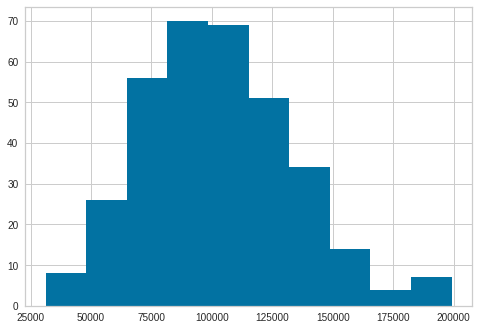

In [ ]:
cust_factors['km_to_trye_change'].hist()

In [ ]:
cust_factors['km_to_trye_change'].describe()

count       339.000000
mean     103227.794337
std       31283.817107
min       31278.390000
25%       80751.320833
50%      101827.270000
75%      123135.061111
max      199142.590000
Name: km_to_trye_change, dtype: float64

In [ ]:
cust_factors['cost/km']=450/cust_factors['km_to_trye_change']

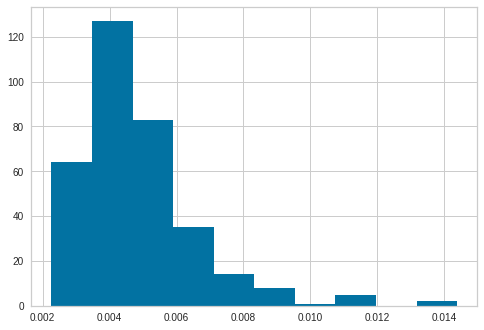

In [ ]:
cust_factors['cost/km'].hist()

In [ ]:
cust_factors['cost/km'].describe()

count    339.000000
mean       0.004842
std        0.001797
min        0.002260
25%        0.003655
50%        0.004419
75%        0.005573
max        0.014387
Name: cost/km, dtype: float64

In [ ]:
cust_factors['factor']=cust_factors['cost/km']/cust_factors['cost/km'].median()

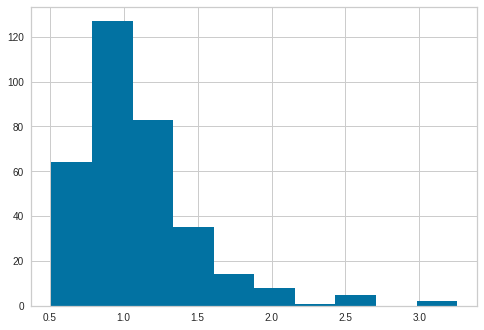

In [ ]:
cust_factors['factor'].hist()

In [ ]:
cust_factors['factor'].describe()

count    339.000000
mean       1.095629
std        0.406589
min        0.511328
25%        0.826957
50%        1.000000
75%        1.261008
max        3.255515
Name: factor, dtype: float64

In [ ]:
cust_factors.to_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/customer_factors.csv')

In [16]:
import pandas as pd
cust_factors=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/customer_factors.csv')

In [17]:
cust_factors.head()

,Unnamed: 0,Customer number,km_to_trye_change,cost/km,factor,cluster
0,0,1000010,111309.654167,0.004043,0.914811,0
1,1,1000024,110749.390417,0.004063,0.919439,0
2,2,1000052,124170.262500,0.003624,0.820062,0
3,3,1000053,111734.260000,0.004027,0.911334,0
4,4,1000057,98342.527500,0.004576,1.035435,2


In [18]:
cust_factors.drop('Unnamed: 0',inplace=True,axis=1)

In [19]:
cust_factors.dtypes

Customer number        int64
km_to_trye_change    float64
cost/km              float64
factor               float64
cluster                int64
dtype: object

In [20]:
cust_factors.iloc[:,1:]=cust_factors.iloc[:,1:].astype('float')

In [21]:
cust_factors.iloc[:,1:]

,km_to_trye_change,cost/km,factor,cluster
0,111309.654167,0.004043,0.914811,0.0
1,110749.390417,0.004063,0.919439,0.0
2,124170.262500,0.003624,0.820062,0.0
3,111734.260000,0.004027,0.911334,0.0
4,98342.527500,0.004576,1.035435,2.0
...,...,...,...,...
334,95046.375000,0.004735,1.071343,2.0
335,86570.020000,0.005198,1.176242,2.0
336,68766.160000,0.006544,1.480776,2.0
337,60093.510000,0.007488,1.694480,1.0


In [22]:
cust_factors.describe()

,Customer number,km_to_trye_change,cost/km,factor,cluster
count,3.390000e+02,339.000000,339.000000,339.000000,339.000000
mean,1.001274e+06,103227.794337,0.004842,1.095629,0.976401
std,7.607011e+02,31283.817107,0.001797,0.406589,0.957393
min,1.000010e+06,31278.390000,0.002260,0.511328,0.000000
25%,1.000668e+06,80751.320833,0.003655,0.826957,0.000000
50%,1.001129e+06,101827.270000,0.004419,1.000000,1.000000
75%,1.002091e+06,123135.061111,0.005573,1.261008,2.000000
max,1.002753e+06,199142.590000,0.014387,3.255515,2.000000


In [23]:
X=cust_factors.iloc[:,1:]

In [24]:
X.min()

km_to_trye_change    31278.390000
cost/km                  0.002260
factor                   0.511328
cluster                  0.000000
dtype: float64

In [25]:
X_std = (X - X.min(axis=0)) / (X.max(axis=0) - X.min(axis=0))
X_std.describe()

,km_to_trye_change,cost/km,factor,cluster
count,339.000000,339.000000,339.000000,339.000000
mean,0.428617,0.212923,0.212923,0.488201
std,0.186364,0.148164,0.148164,0.478696
min,0.000000,0.000000,0.000000,0.000000
25%,0.294720,0.115017,0.115017,0.000000
50%,0.420274,0.178075,0.178075,0.500000
75%,0.547208,0.273188,0.273188,1.000000
max,1.000000,1.000000,1.000000,1.000000


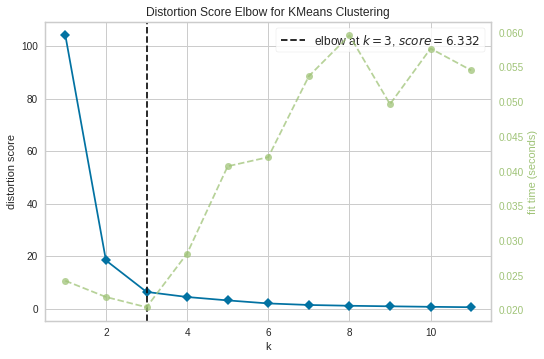

In [26]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,12)).fit(X_std)
visualizer.show()

In [27]:
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=0).fit(X_std)

In [28]:
cust_factors['cluster']=kmeans.labels_
cust_factors

,Customer number,km_to_trye_change,cost/km,factor,cluster
0,1000010,111309.654167,0.004043,0.914811,1
1,1000024,110749.390417,0.004063,0.919439,1
2,1000052,124170.262500,0.003624,0.820062,1
3,1000053,111734.260000,0.004027,0.911334,1
4,1000057,98342.527500,0.004576,1.035435,0
...,...,...,...,...,...
334,1002627,95046.375000,0.004735,1.071343,0
335,1002667,86570.020000,0.005198,1.176242,0
336,1002674,68766.160000,0.006544,1.480776,0
337,1002689,60093.510000,0.007488,1.694480,2


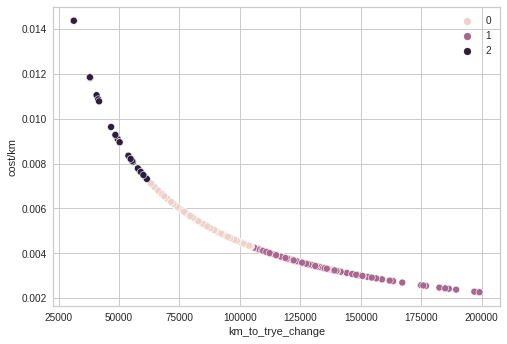

In [29]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.scatterplot(data=cust_factors, x="km_to_trye_change", y="cost/km", hue=kmeans.labels_)
plt.show()

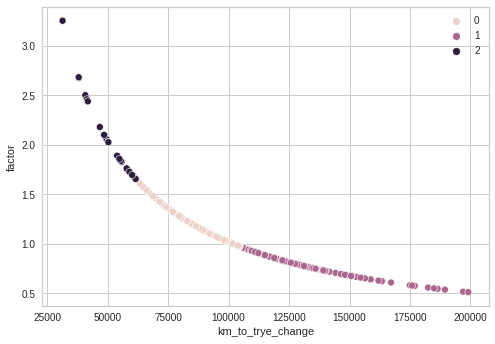

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.scatterplot(data=cust_factors, x="km_to_trye_change", y="factor", hue=kmeans.labels_)
plt.show()

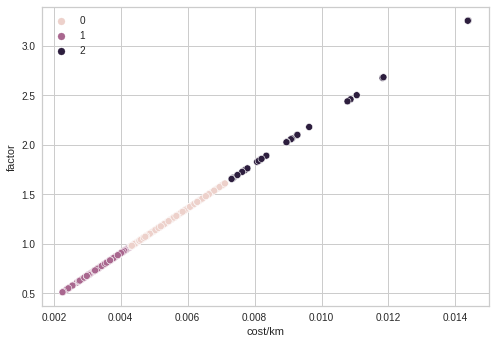

In [31]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.scatterplot(data=cust_factors, x="cost/km", y="factor", hue=kmeans.labels_)
plt.show()

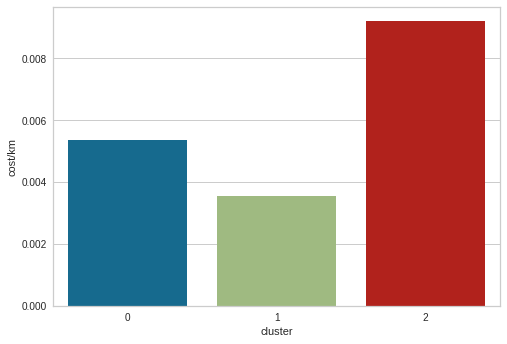

In [32]:
df=cust_factors.groupby('cluster')['cost/km'].mean().reset_index()
sns.barplot(data=df, x="cluster", y="cost/km")
plt.show()

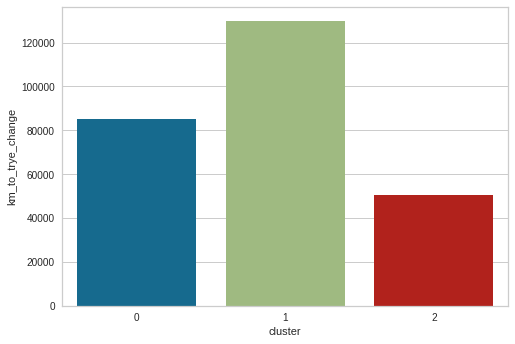

In [33]:
df=cust_factors.groupby('cluster')['km_to_trye_change'].mean().reset_index()
sns.barplot(data=df, x="cluster", y='km_to_trye_change')
plt.show()

In [34]:
#higher speed- lesser friction- lesser wear and tear

In [35]:
cust_factors.to_csv('/content/drive/MyDrive/Colab Notebooks/KRONE/customer_segments.csv',index=False)

In [38]:
cust_factors.shape

(339, 5)